In [44]:
import os
import numpy as np
import librosa
import matplotlib.pyplot as plt
import dlib
from imutils import face_utils
from scipy.spatial import distance
import cv2
import subprocess
import glob

In [97]:
video_path = '/Users/changdae/Desktop/exception/video/CScH_658uNA.mp4'
detector = dlib.get_frontal_face_detector()
landmark_predictor = dlib.shape_predictor('./models/shape_predictor_68_face_landmarks.dat')
x = 0.795312
y = 0.540741

In [98]:
def get_center(shape):
    center_x = int(round(np.sum(shape[:, 0]) / 68))
    center_y = int(round(np.sum(shape[:, 1]) / 68)) - 25
    return center_x, center_y

# def get_center(shape):
#     center_x = int((shape[0, 0] + shape[16, 0]) / 2)
#     center_y = int((shape[0, 1] + shape[16, 1]) / 2)
#     print(center_x, center_y)
#     return center_x, center_y

# def get_center(shape):
#     center_x = int(round(np.sum(shape[:27, 0]) / 27))
#     center_y = int(round(np.sum(shape[:27, 1]) / 27))
#     return center_x, center_y

def crop_face(vc, norm_x, norm_y, fourcc, vid_writer, crop_size=224):
    print('Crop face..')
    f_w = int(vc.get(cv2.CAP_PROP_FRAME_WIDTH))
    f_h = int(vc.get(cv2.CAP_PROP_FRAME_HEIGHT))
    length = int(vc.get(cv2.CAP_PROP_FRAME_COUNT))
    print(length)
    idx = 0
    scale_factor = None
    prev_center_x = None
    prev_center_y = None
    prev_roiX1 = None
    prev_roiY1 = None
    prev_roiX2 = None
    prev_roiY2 = None

    while True:
        print(idx)
        idx += 1
        bgr_img = vc.read()[1]
        if bgr_img is None:
            break
        rgb_img = cv2.cvtColor(bgr_img, cv2.COLOR_BGR2RGB)
        # dlib face detection
        dlib_rects = detector(rgb_img, 1)  # dlib bbox detection
        list_dlib_rect = list(dlib_rects)
        # if len(dlib_rects) != 0:
        #     dlib_rect = max(dlib_rects, key=lambda rect: rect.width() * rect.height())
        #     list_dlib_rect = [dlib_rect]

        # Exception handling 1: Detected more than one, find closest to given coordinate.
        if len(list_dlib_rect) > 1:
            print('Exception - 1')
            frame_h, frame_w, _ = rgb_img.shape
            abs_x = round(norm_x * frame_w)
            abs_y = round(norm_y * frame_h)
            closest_rect = None
            closest_distance = 9999
            for k, rect in enumerate(list_dlib_rect):
                (x, y, w, h) = face_utils.rect_to_bb(rect)
                center_x = (x + (x + w)) / 2
                center_y = (y + (y + h)) / 2
                cur_distance = distance.euclidean((abs_x, abs_y), (center_x, center_y))
                if cur_distance < closest_distance:
                    closest_rect = rect
                    closest_distance = cur_distance
            list_dlib_rect = [closest_rect]

        # Predict landmark
        list_landmarks = []
        for rect in list_dlib_rect:
            shape = landmark_predictor(rgb_img, rect)
            list_points = list(map(lambda p: (p.x, p.y), shape.parts()))
            list_landmarks.append(list_points)
            shape = face_utils.shape_to_np(shape)
            plt.imshow(rgb_img)
            plt.scatter(shape[:, 0], shape[:, 1])
            plt.show()
            center_x, center_y = get_center(shape)
            frame_h, frame_w, _ = rgb_img.shape
            abs_x = round(norm_x * frame_w)
            abs_y = round(norm_y * frame_h)
            # Calculate inter-ocular distance at first detected frame and resize image.
            if scale_factor is None:
                print('Set Scale factor')
                left_eye_x = (shape[36][0] + shape[39][0]) / 2
                left_eye_y = (shape[38][1] + shape[40][1]) / 2
                right_eye_x = (shape[42][0] + shape[45][0]) / 2
                right_eye_y = (shape[43][1] + shape[46][1]) / 2
                interocular_distance = round(
                    distance.euclidean((left_eye_x, left_eye_y), (right_eye_x, right_eye_y)))
                scale_factor = 55 / interocular_distance
                print('Distance :', interocular_distance)
                print('Scale Factor :', scale_factor)
            rgb_img = cv2.resize(rgb_img, None, fx=scale_factor, fy=scale_factor)
            frame_h, frame_w, _ = rgb_img.shape
            abs_x = round(norm_x * frame_w)
            abs_y = round(norm_y * frame_h)

            # At first detected frame, set previous center coordinate as given coordinate
            if prev_center_x is None and prev_center_y is None:
                prev_center_x, prev_center_y = abs_x, abs_y

            center_x = round(center_x * scale_factor)
            center_y = round(center_y * scale_factor)

            # Exception handling 2: Detected face center is too far from previous frame's center.
            # There's a possibiliy that detected face is not target's.
            # So just use previous center as current frame's center.
            if abs(center_x - prev_center_x) > 60 or abs(center_y - prev_center_y) > 40:
                print('--------------')
                print('Exception - 2')
                print(prev_center_x, prev_center_y)
                print(center_x, center_y)
                print('--------------')
                center_x = prev_center_x
                center_y = prev_center_y
            else:
                prev_center_x = center_x
                prev_center_y = center_y

        # Crop face.
        margin = int(crop_size / 2)
        if len(list_landmarks) != 0:
            roiX1 = center_x - margin if center_x - margin > 0 else 0
            roiY1 = center_y - margin if center_y - margin > 0 else 0
            roiX2 = center_x + margin if center_x + margin < rgb_img.shape[1] else rgb_img.shape[1]
            roiY2 = center_y + margin if center_y + margin < rgb_img.shape[0] else rgb_img.shape[0]
        else:
            # Exception handling 3: Detected nothing in,
            # 1. at (second to last) frame, use same ROI of previous frame.
            # 2. or, at frist frame, skip this video.
            if prev_roiX1 is not None:
                print('Exception - 3')
                if scale_factor is not None:
                    rgb_img = cv2.resize(rgb_img, None, fx=scale_factor, fy=scale_factor)
                roiX1 = prev_roiX1
                roiY1 = prev_roiY1
                roiX2 = prev_roiX2
                roiY2 = prev_roiY2
            else:
                return False
        prev_roiX1 = roiX1
        prev_roiY1 = roiY1
        prev_roiX2 = roiX2
        prev_roiY2 = roiY2
        img_face = rgb_img[roiY1:roiY2, roiX1:roiX2].copy()
        img_face = cv2.cvtColor(img_face, cv2.COLOR_RGB2BGR)
        img_face = cv2.resize(img_face, (224, 224))
        plt.imshow(img_face)
        plt.show()
        vid_writer.write(img_face)
    print('Cropping is done.')
    return True

Crop face..
129
0


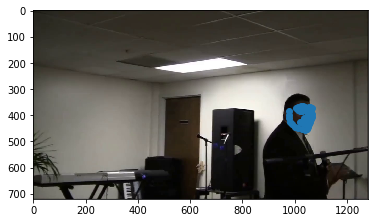

Set Scale factor
Distance : 33
Scale Factor : 1.6666666666666667


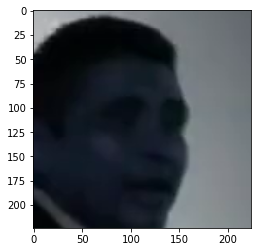

1


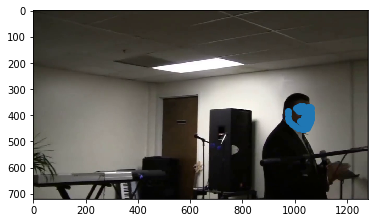

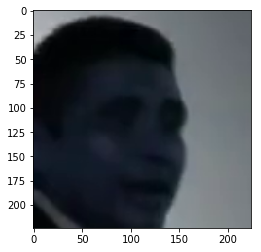

2


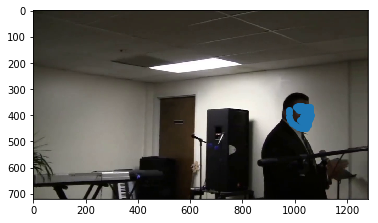

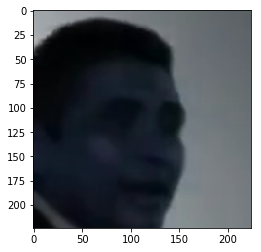

3


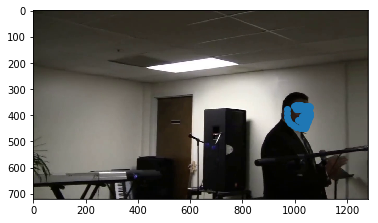

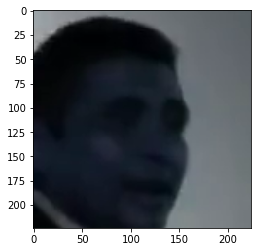

4


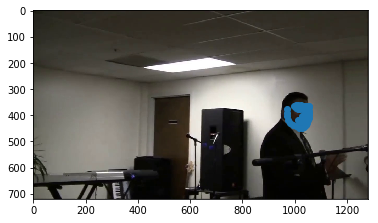

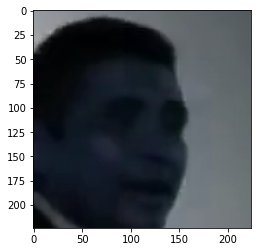

5


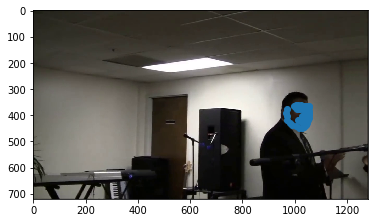

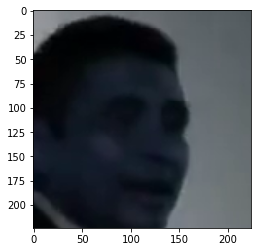

6


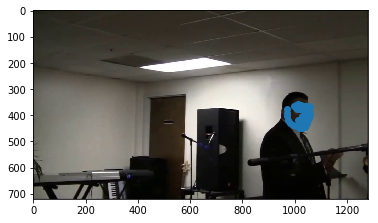

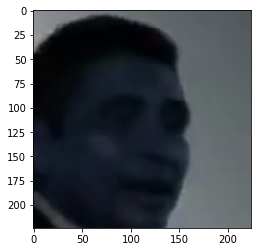

7


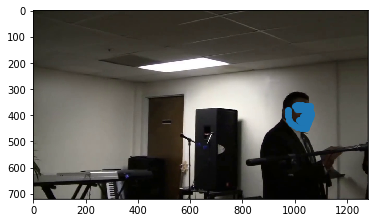

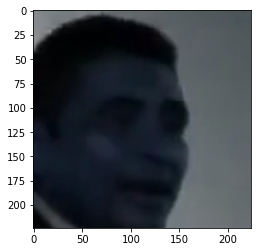

8


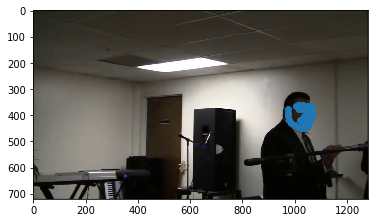

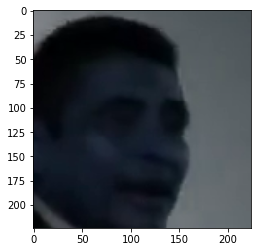

9


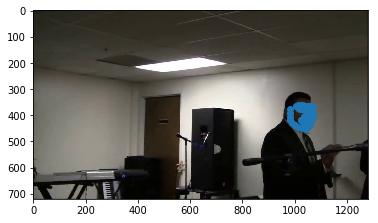

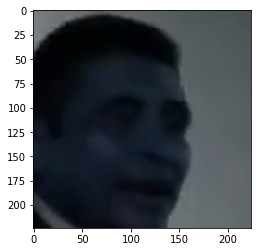

10


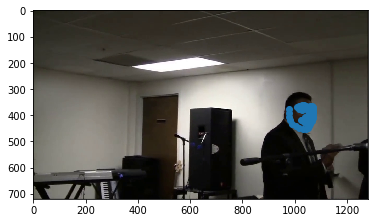

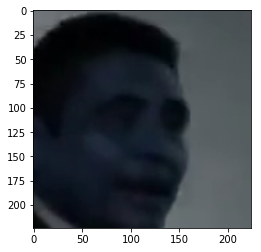

11


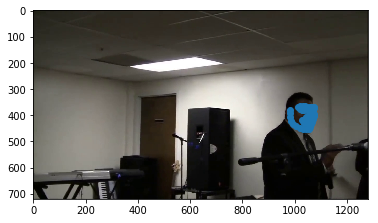

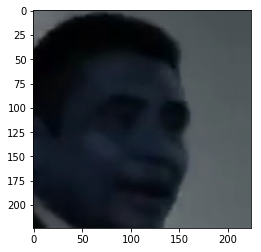

12


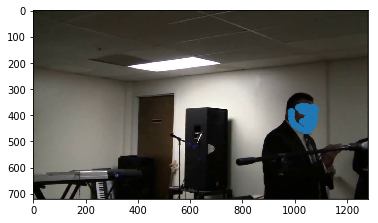

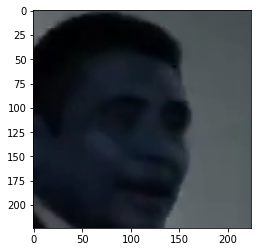

13


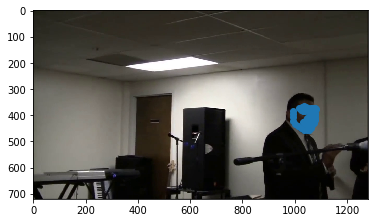

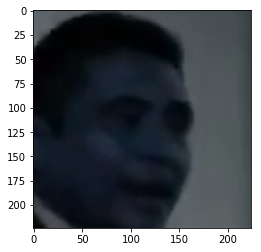

14


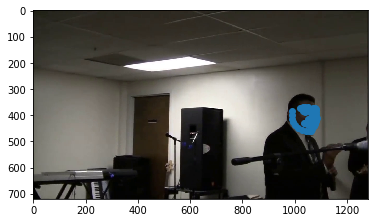

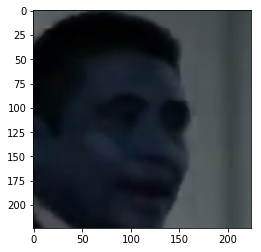

15


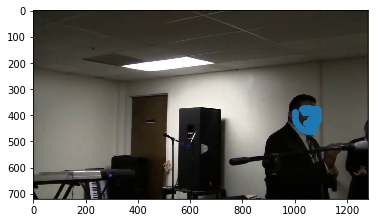

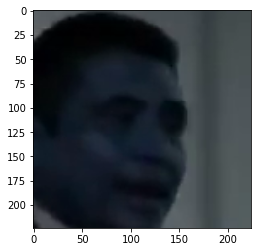

16


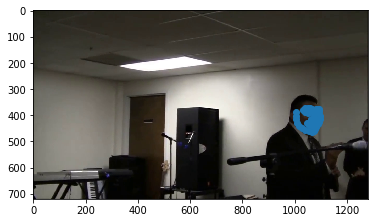

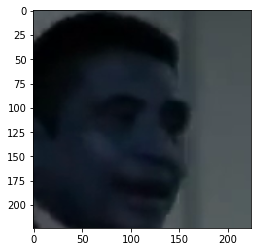

17


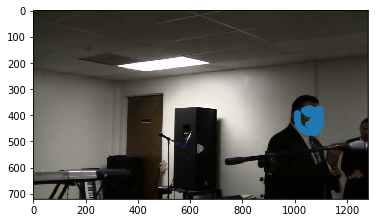

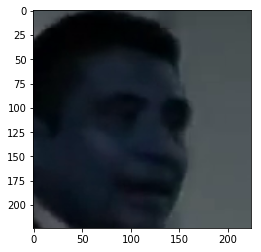

18


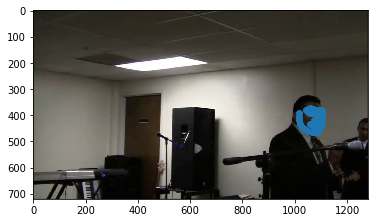

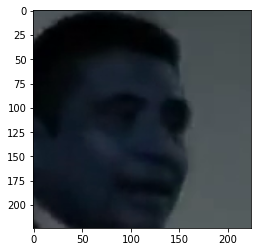

19


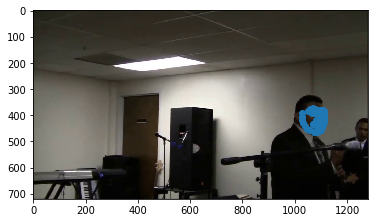

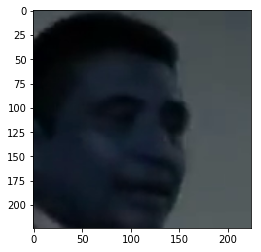

20


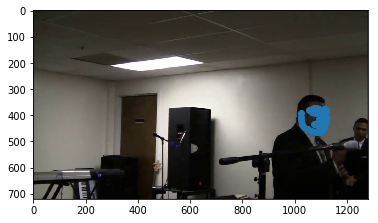

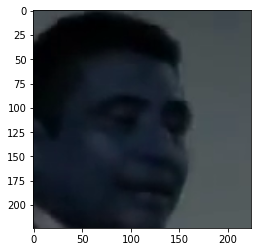

21


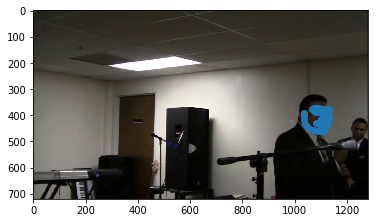

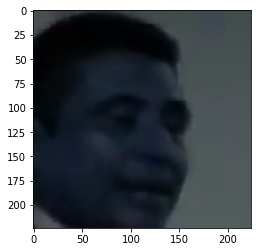

22


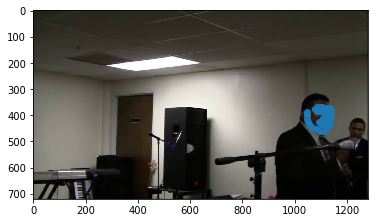

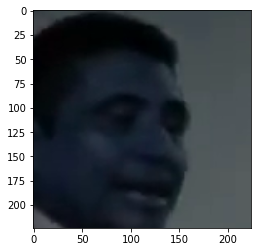

23


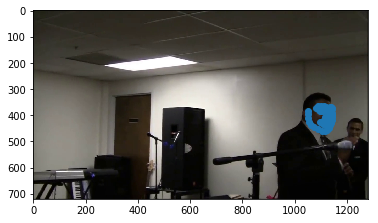

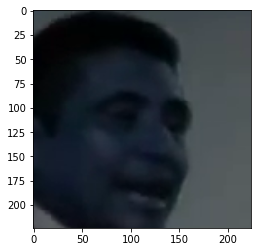

24


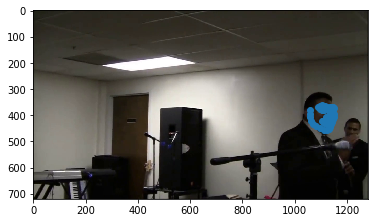

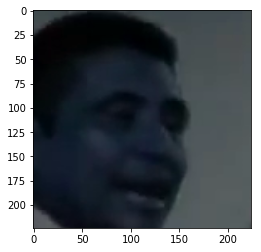

25


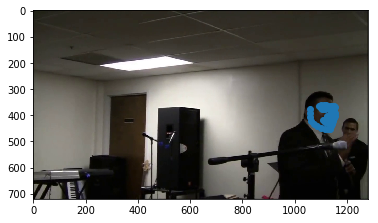

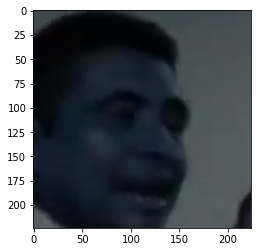

26


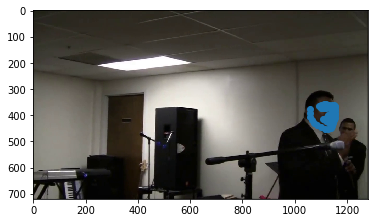

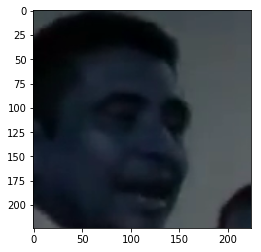

27


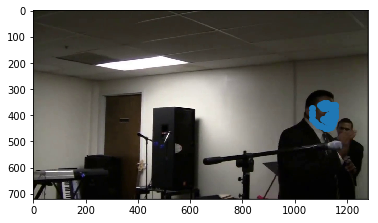

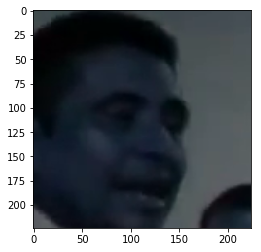

28


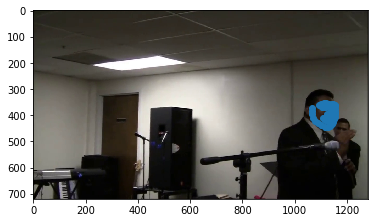

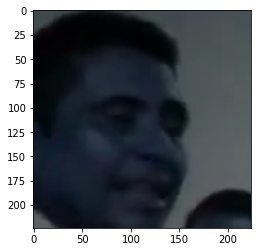

29


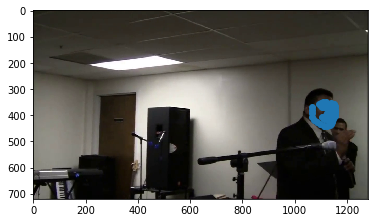

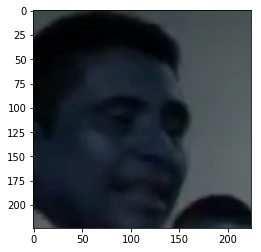

30


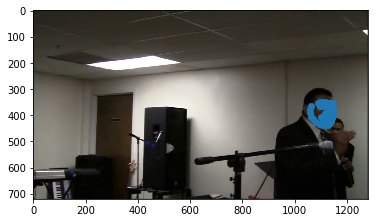

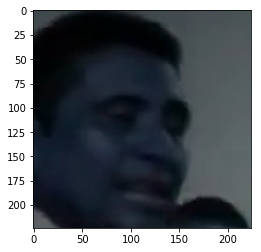

31


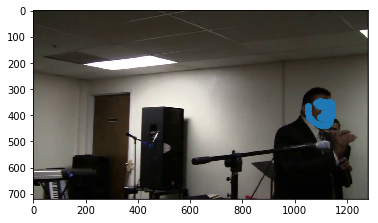

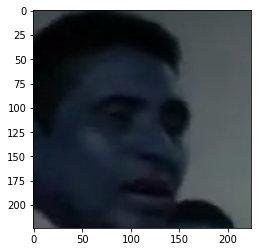

32


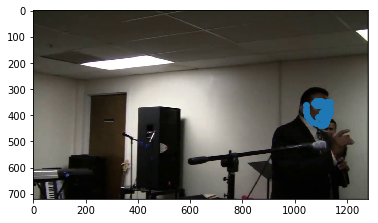

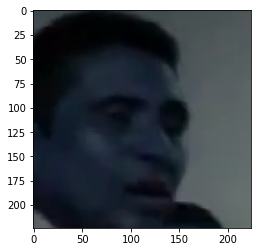

33


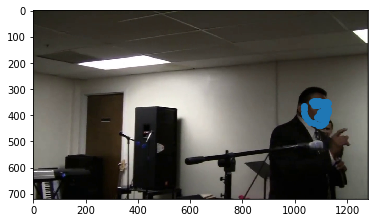

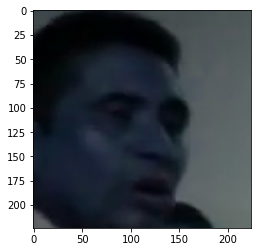

34


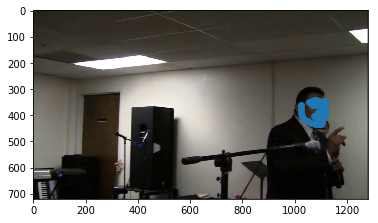

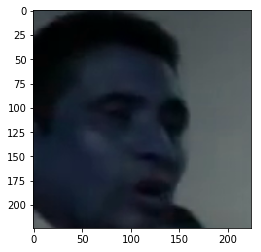

35


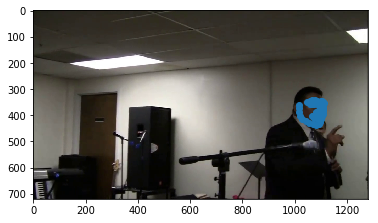

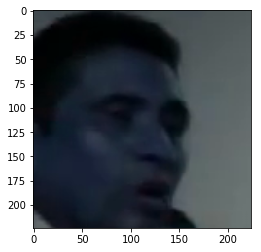

36


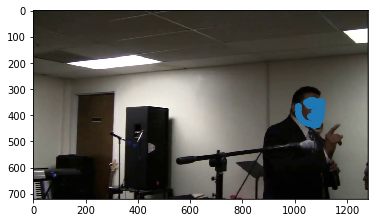

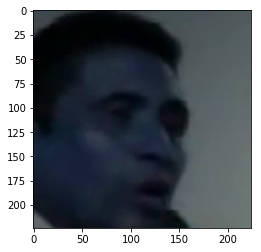

37


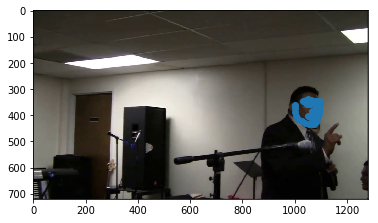

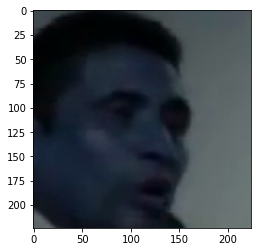

38


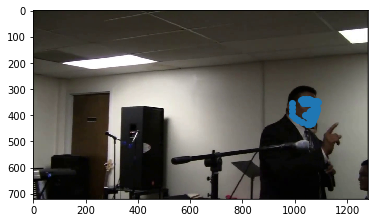

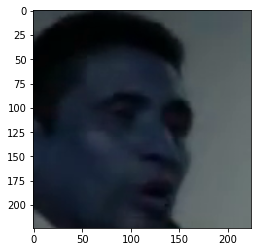

39


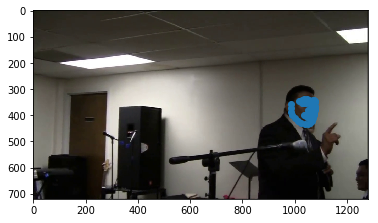

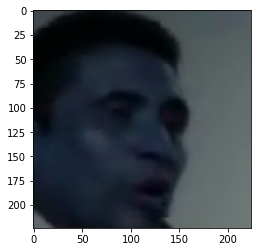

40


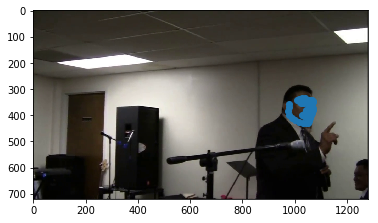

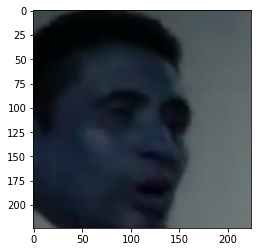

41


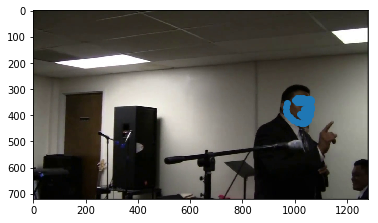

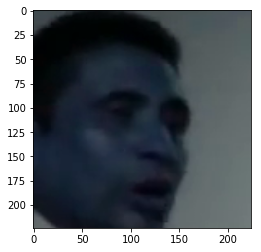

42


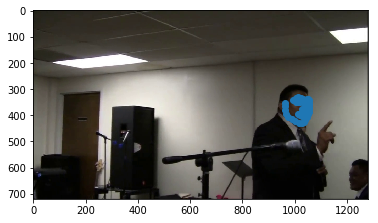

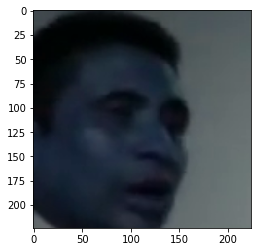

43


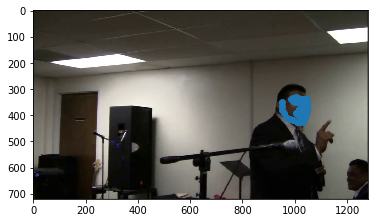

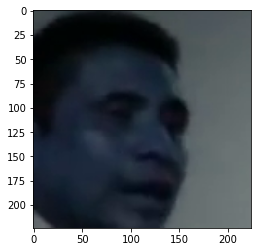

44


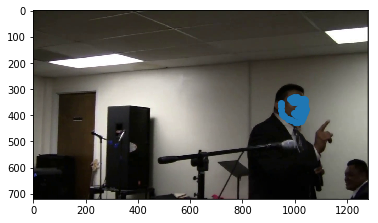

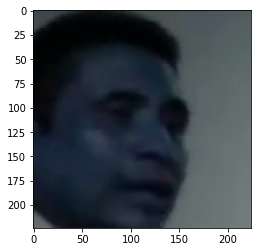

45


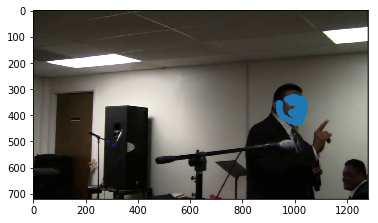

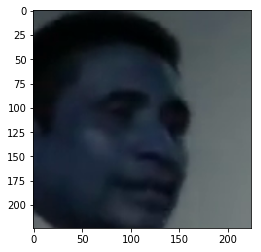

46


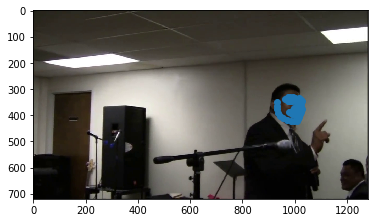

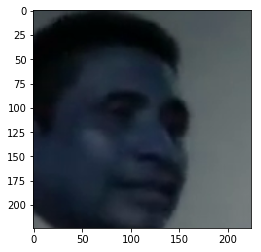

47


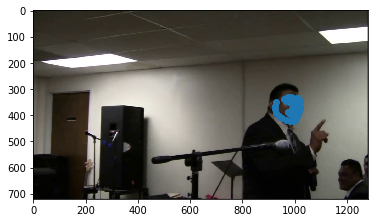

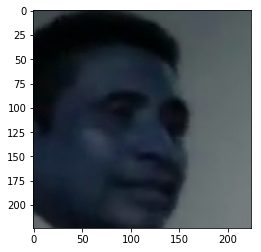

48


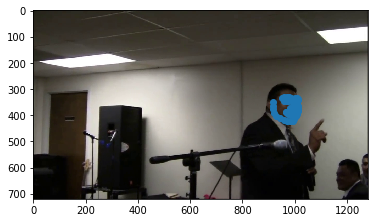

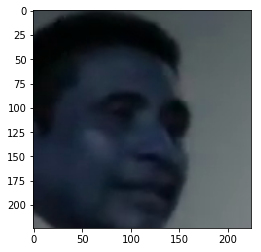

49


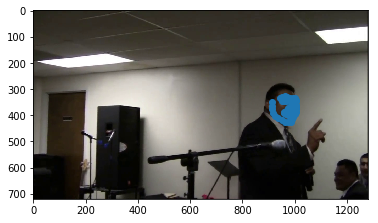

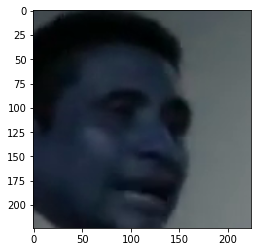

50


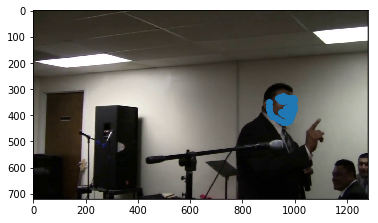

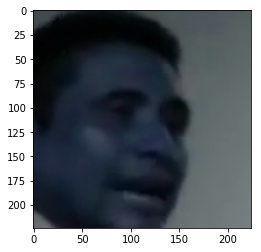

51
Exception - 1


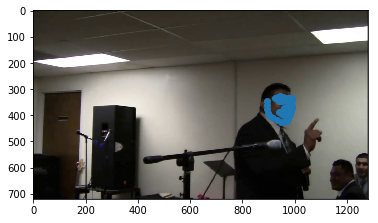

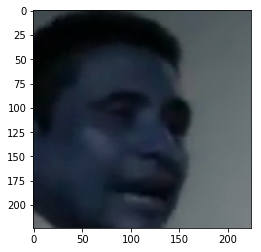

52
Exception - 1


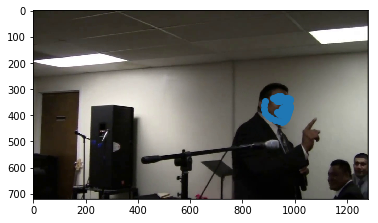

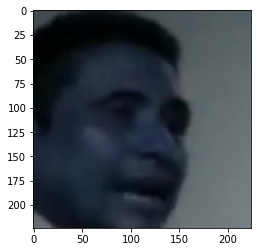

53
Exception - 1


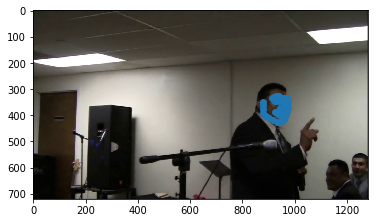

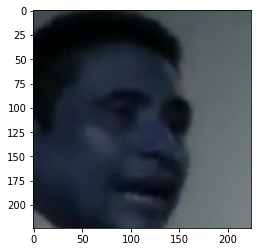

54
Exception - 1


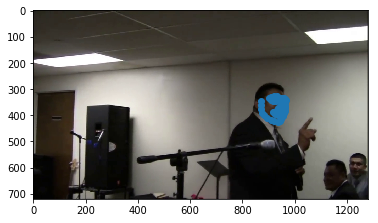

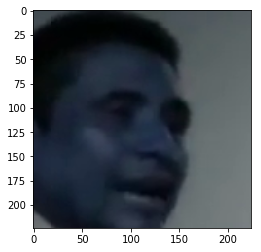

55
Exception - 1


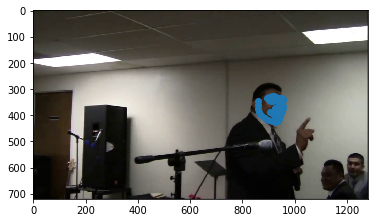

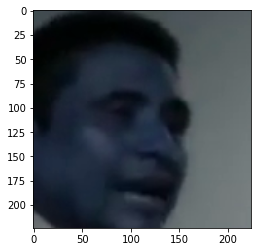

56
Exception - 1


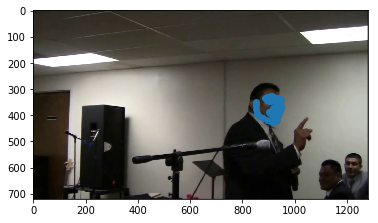

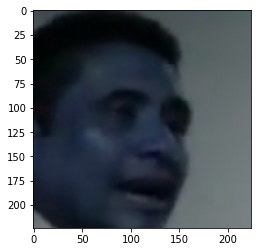

57
Exception - 1


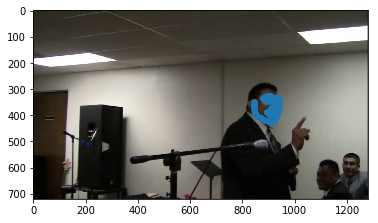

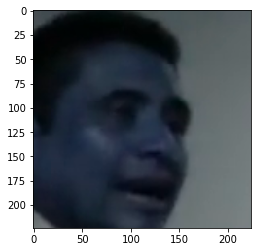

58
Exception - 1


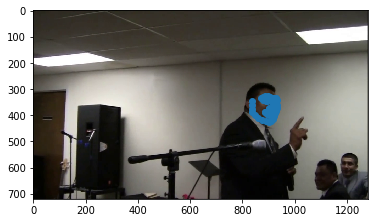

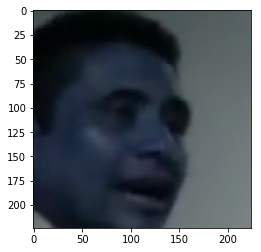

59
Exception - 1


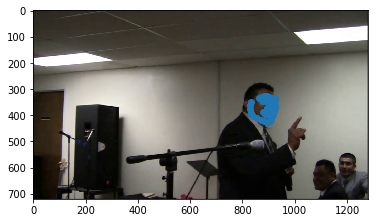

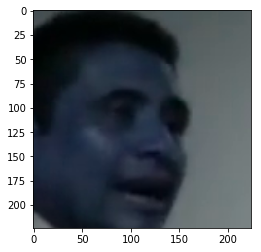

60
Exception - 1


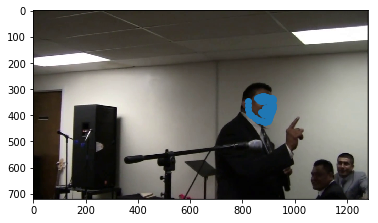

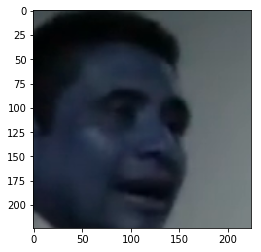

61
Exception - 1


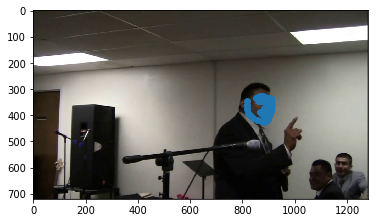

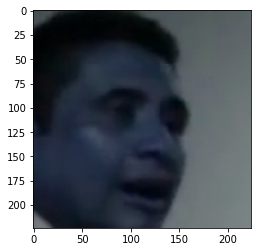

62
Exception - 1


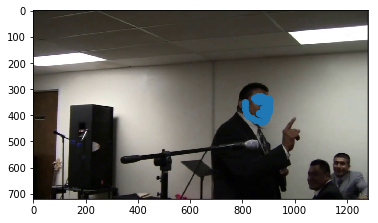

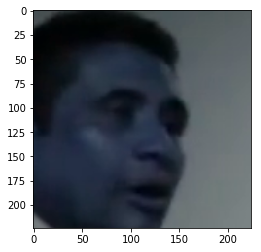

63
Exception - 1


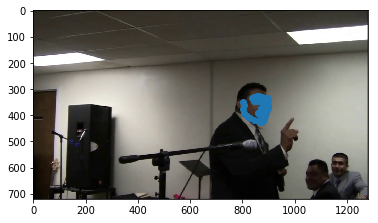

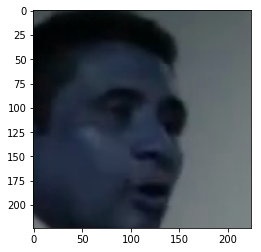

64
Exception - 1


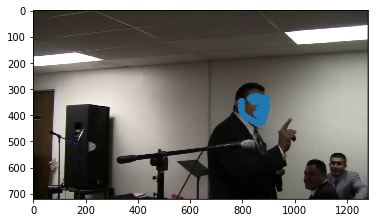

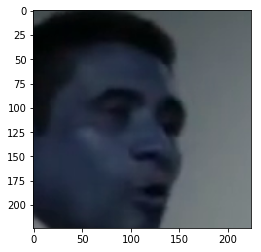

65
Exception - 1


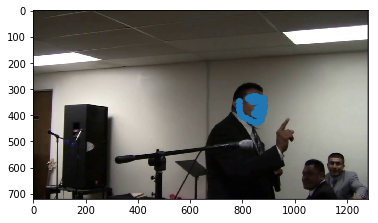

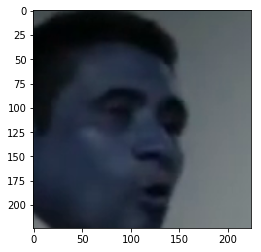

66


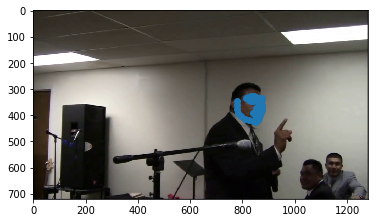

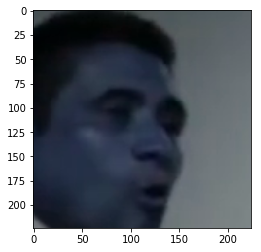

67
Exception - 1


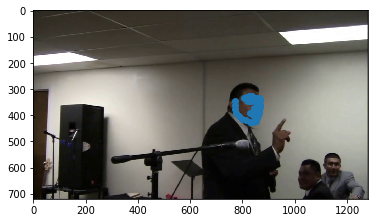

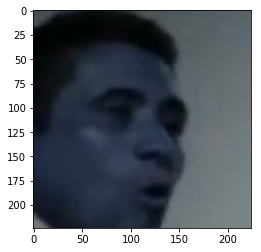

68
Exception - 1


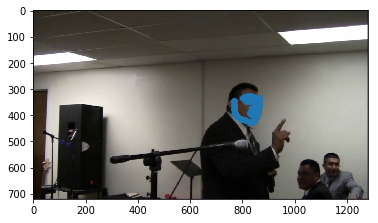

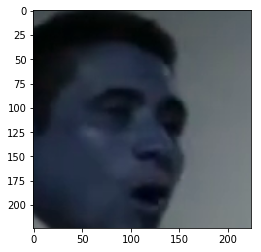

69
Exception - 1


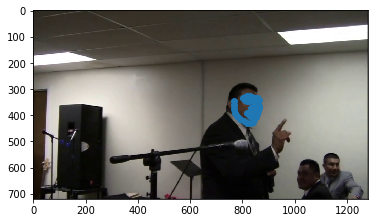

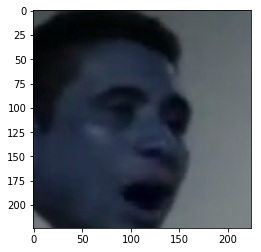

70
Exception - 1


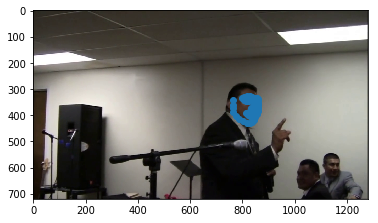

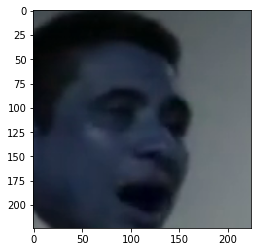

71
Exception - 1


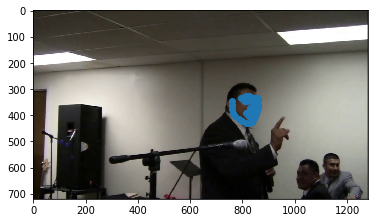

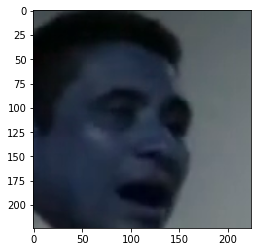

72
Exception - 1


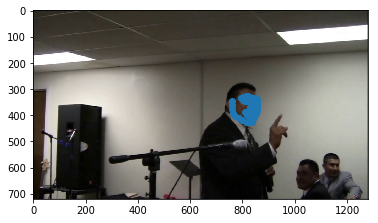

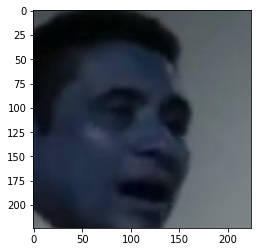

73
Exception - 1


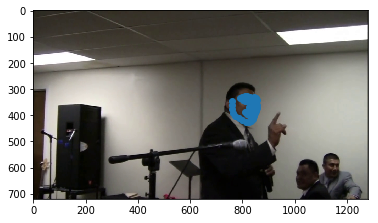

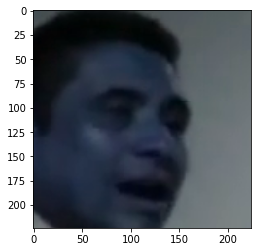

74
Exception - 1


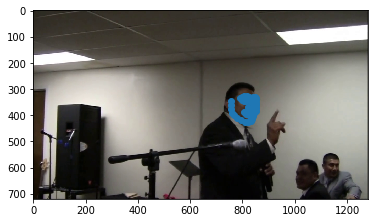

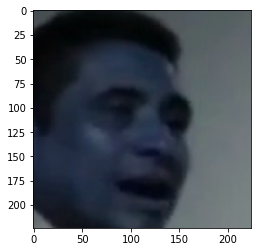

75
Exception - 1


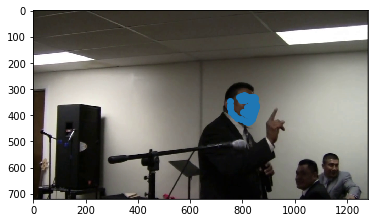

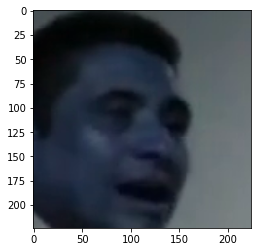

76
Exception - 1


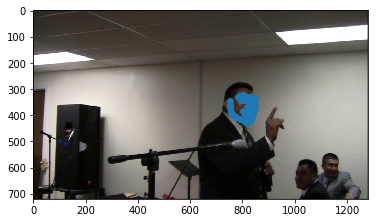

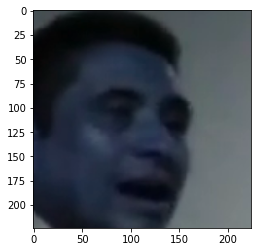

77
Exception - 1


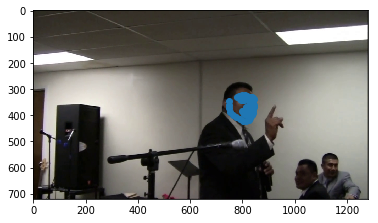

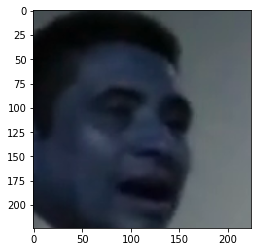

78
Exception - 1


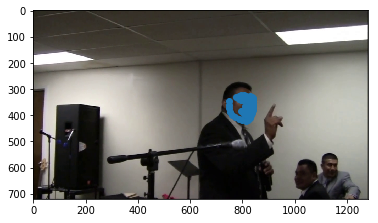

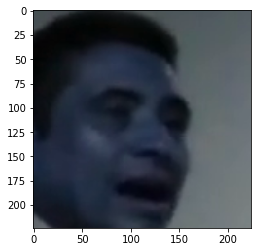

79
Exception - 1


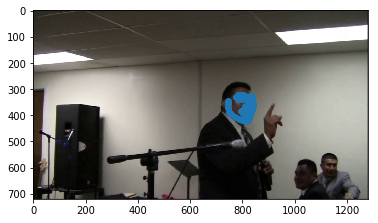

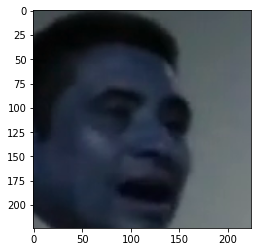

80
Exception - 1


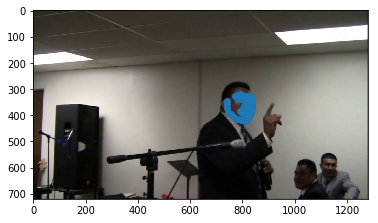

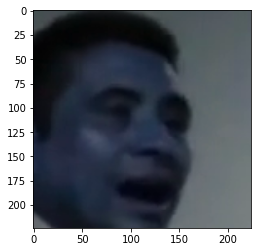

81
Exception - 1


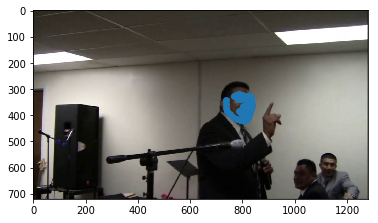

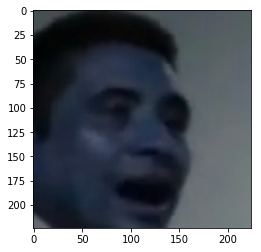

82
Exception - 1


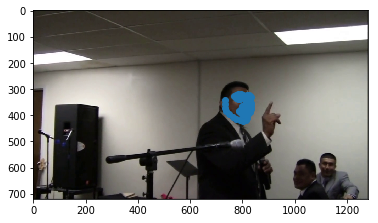

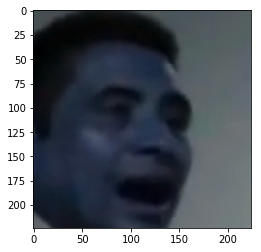

83
Exception - 1


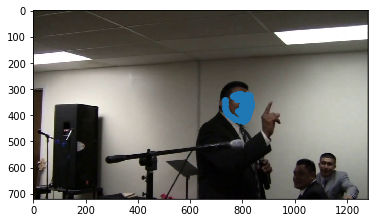

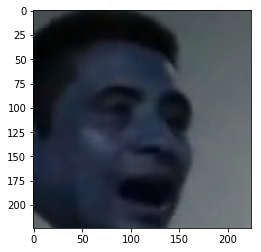

84
Exception - 1


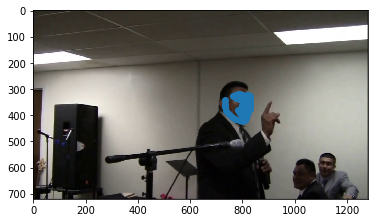

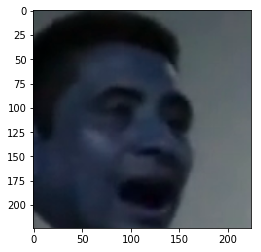

85
Exception - 1


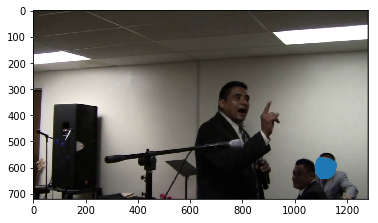

--------------
Exception - 2
1332 565
1853 957
--------------


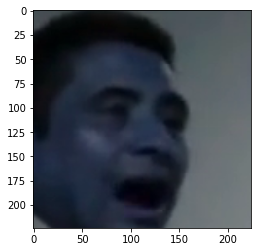

86
Exception - 1


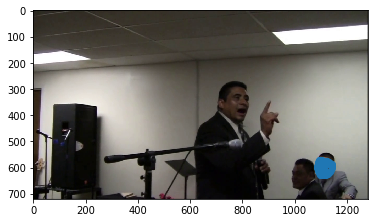

--------------
Exception - 2
1332 565
1848 957
--------------


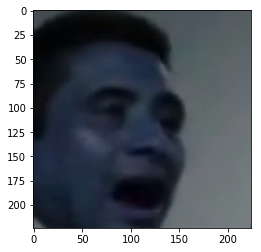

87
Exception - 1


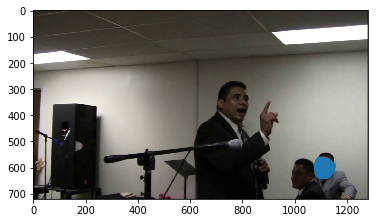

--------------
Exception - 2
1332 565
1845 955
--------------


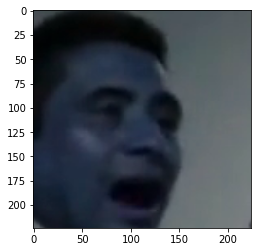

88
Exception - 1


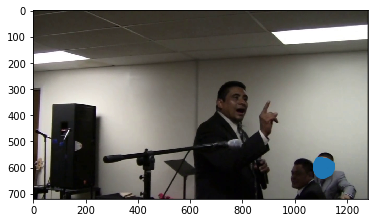

--------------
Exception - 2
1332 565
1842 953
--------------


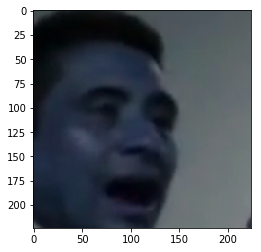

89
Exception - 1


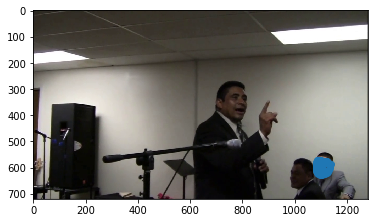

--------------
Exception - 2
1332 565
1837 952
--------------


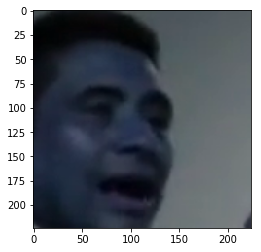

90
Exception - 1


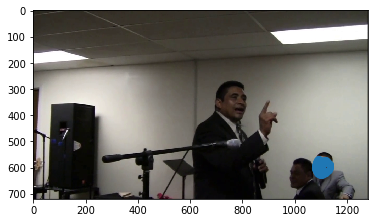

--------------
Exception - 2
1332 565
1835 952
--------------


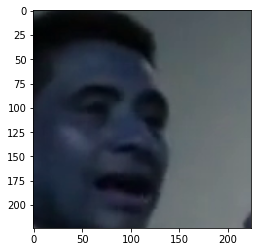

91
Exception - 1


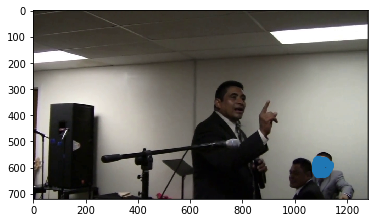

--------------
Exception - 2
1332 565
1832 950
--------------


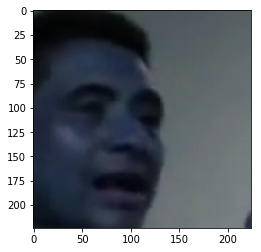

92
Exception - 1


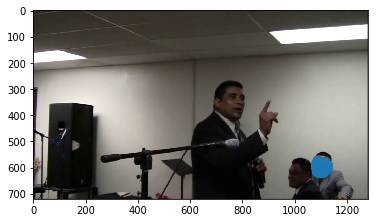

--------------
Exception - 2
1332 565
1827 947
--------------


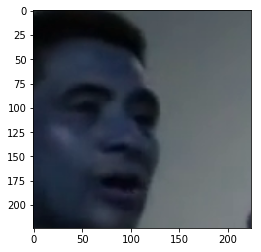

93
Exception - 1


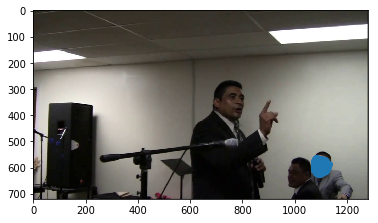

--------------
Exception - 2
1332 565
1825 945
--------------


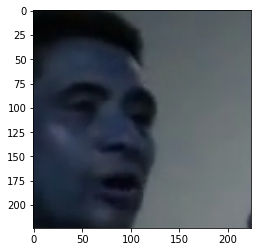

94


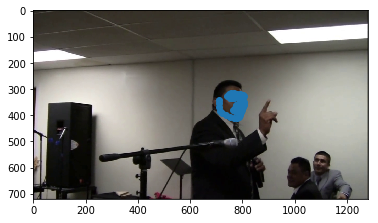

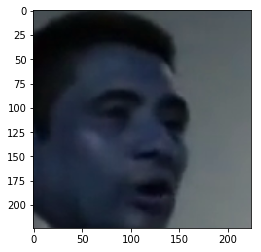

95
Exception - 1


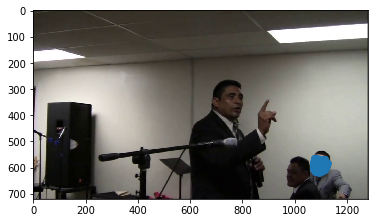

--------------
Exception - 2
1295 557
1818 938
--------------


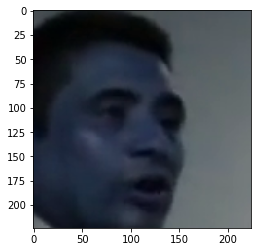

96
Exception - 1


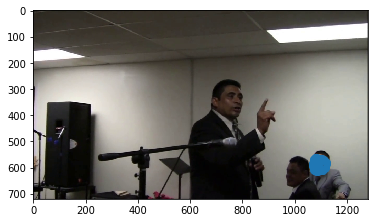

--------------
Exception - 2
1295 557
1815 937
--------------


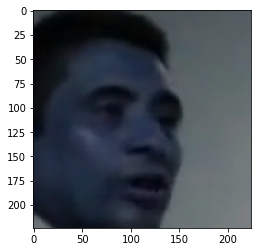

97
Exception - 1


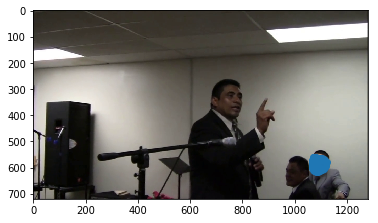

--------------
Exception - 2
1295 557
1812 933
--------------


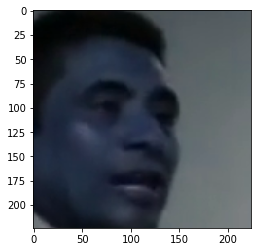

98
Exception - 1


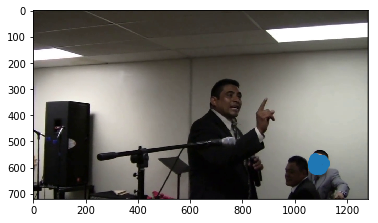

--------------
Exception - 2
1295 557
1808 932
--------------


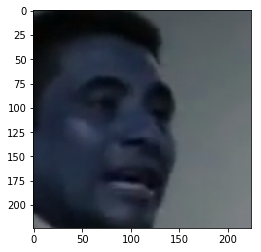

99
Exception - 1


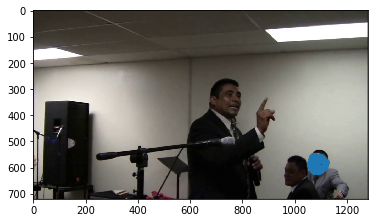

--------------
Exception - 2
1295 557
1805 930
--------------


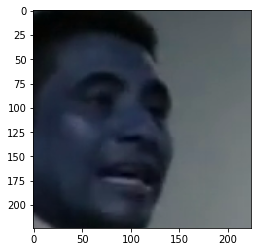

100
Exception - 1


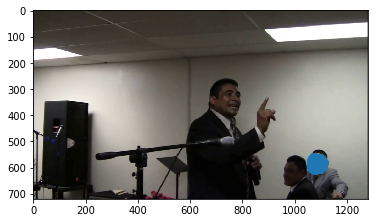

--------------
Exception - 2
1295 557
1802 928
--------------


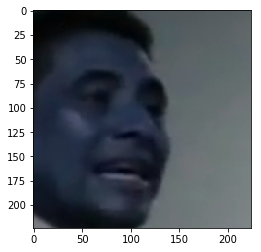

101
Exception - 1


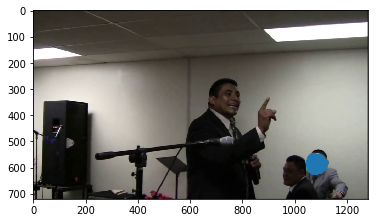

--------------
Exception - 2
1295 557
1798 928
--------------


KeyboardInterrupt: 

In [99]:
fourcc = cv2.VideoWriter_fourcc(*'avc1')
vc = cv2.VideoCapture(video_path)
fps = 25.0
vid_writer = cv2.VideoWriter('./sample_result.mp4',
                             fourcc,
                             fps,
                             (224, 224))
crop_face(vc, x, y, fourcc, vid_writer)

In [51]:
cropped_video = '/Users/changdae/Desktop/MARG_Multi_Modal/dataset/result/original/cropped/b0J4hNA3b-E.mp4'

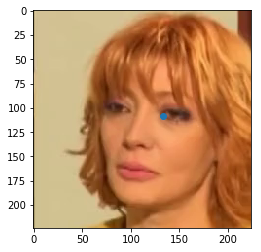

55


In [56]:
vc = cv2.VideoCapture(cropped_video)

while True:
    bgr_img = vc.read()[1]
    rgb_img = cv2.cvtColor(bgr_img, cv2.COLOR_BGR2RGB)
    # dlib face detection
    dlib_rects = detector(rgb_img, 1)  # dlib bbox detection
    list_dlib_rect = list(dlib_rects)
    
    list_landmarks = []
    for rect in list_dlib_rect:
        shape = landmark_predictor(rgb_img, rect)
        list_points = list(map(lambda p: (p.x, p.y), shape.parts()))
        list_landmarks.append(list_points)
        shape = face_utils.shape_to_np(shape)
        plt.imshow(rgb_img)
        plt.scatter(shape[42, 0], shape[42, 1])
        plt.show()
        
        left_eye_x = (shape[36][0] + shape[39][0]) / 2
        left_eye_y = (shape[38][1] + shape[40][1]) / 2
        right_eye_x = (shape[42][0] + shape[45][0]) / 2
        right_eye_y = (shape[43][1] + shape[46][1]) / 2
        interocular_distance = round(
            distance.euclidean((left_eye_x, left_eye_y), (right_eye_x, right_eye_y)))
        print(interocular_distance)
    break

In [75]:
video_sample = glob.glob('/Users/changdae/Desktop/MARG_Multi_Modal/dataset/result/original/cropped/*mp4')
print(len(video_sample))

6


In [76]:
for vid in video_sample:
    vc = cv2.VideoCapture(vid)
    print(vid, vc.get(cv2.CAP_PROP_FPS))

/Users/changdae/Desktop/MARG_Multi_Modal/dataset/result/original/cropped/05d0sNBvb_Q.mp4 0.0
/Users/changdae/Desktop/MARG_Multi_Modal/dataset/result/original/cropped/CScH_658uNA.mp4 25.0
/Users/changdae/Desktop/MARG_Multi_Modal/dataset/result/original/cropped/Ed0DOitGVPY.mp4 25.0
/Users/changdae/Desktop/MARG_Multi_Modal/dataset/result/original/cropped/G1zWw7HKX8A.mp4 25.0
/Users/changdae/Desktop/MARG_Multi_Modal/dataset/result/original/cropped/HOWz0cqrqxc.mp4 25.0
/Users/changdae/Desktop/MARG_Multi_Modal/dataset/result/original/cropped/ZF4p8bHodfk.mp4 25.0


False
29.97
129


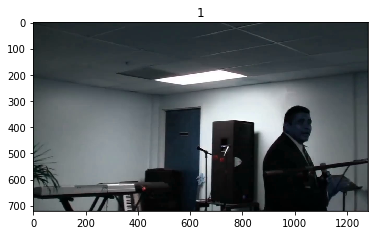

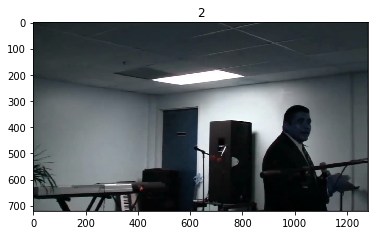

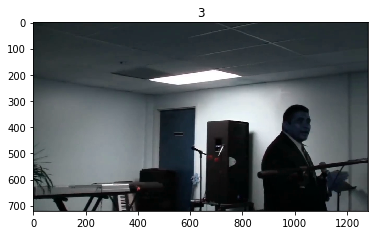

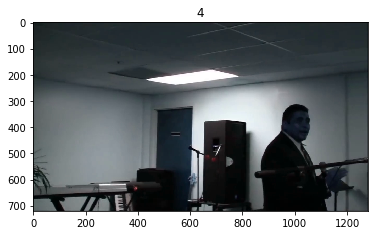

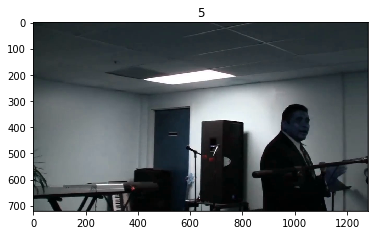

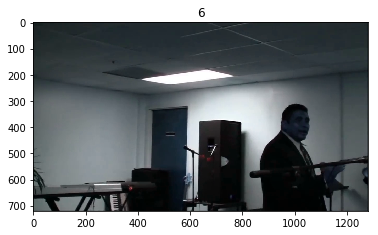

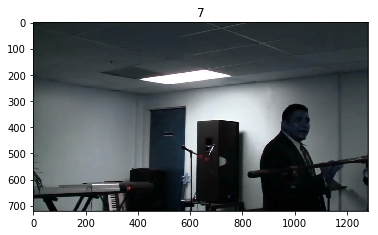

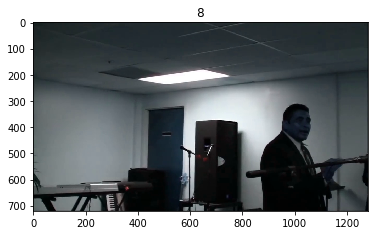

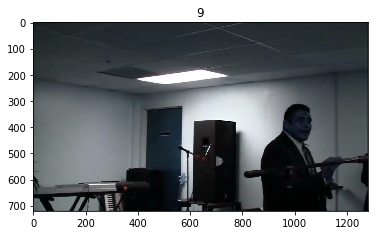

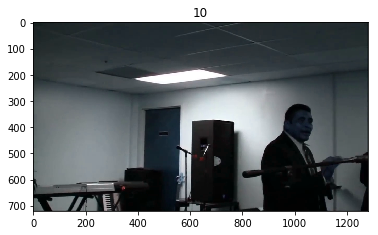

KeyboardInterrupt: 

In [79]:
video_sample = '/Users/changdae/Desktop/MARG_Multi_Modal/dataset/result/original/video/CScH_658uNA.mp4'
vc = cv2.VideoCapture(video_sample)
print(vc.set(cv2.CAP_PROP_FPS, 25.0))
print(vc.get(cv2.CAP_PROP_FPS))
length = int(vc.get(cv2.CAP_PROP_FRAME_COUNT))
print(length)
idx = 0
while True:
    idx += 1
    bgr_img = vc.read()[1]
    if bgr_img is None:
        break
    plt.imshow(bgr_img)
    plt.title(idx)
    plt.show()

In [100]:
video_np = '/Users/changdae/Desktop/MARG_Multi_Modal/dataset/result/numpy/cropped/G1zWw7HKX8A.npy'
all_frame = np.load(video_np)

0


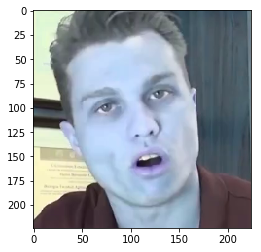

1


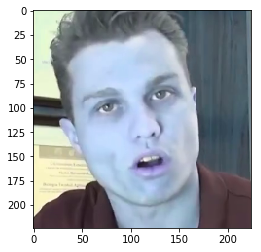

2


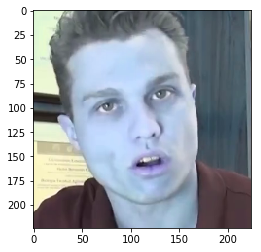

3


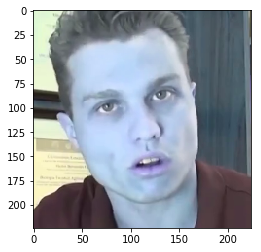

4


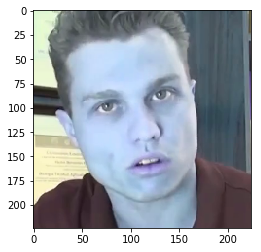

5


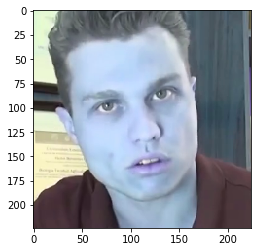

6


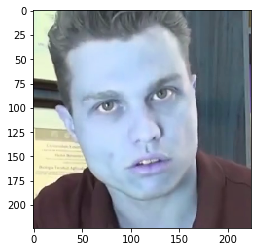

7


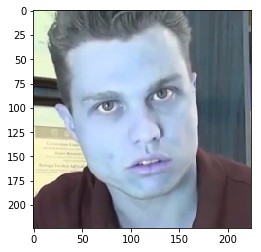

8


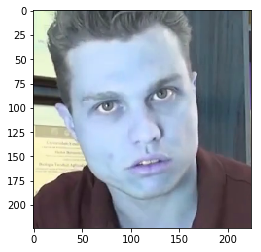

9


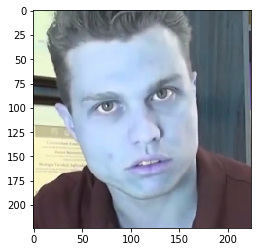

10


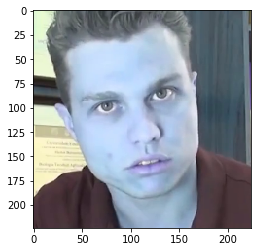

11


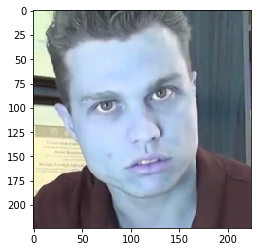

12


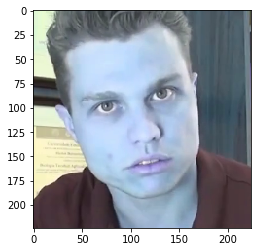

13


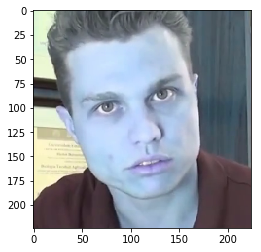

14


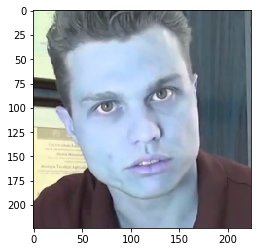

15


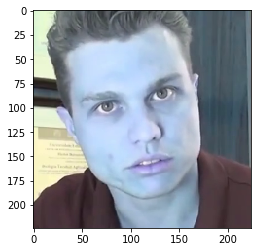

16


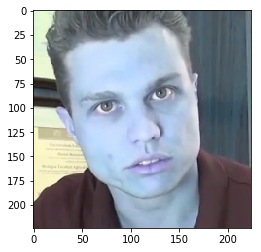

17


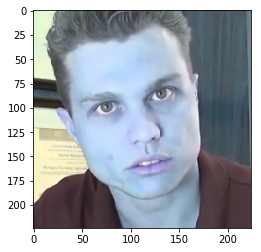

18


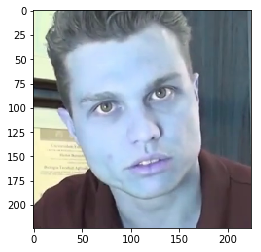

19


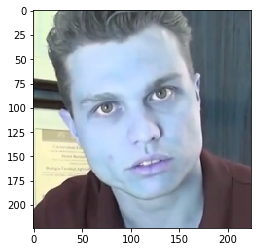

20


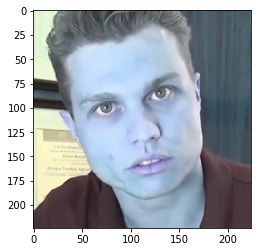

21


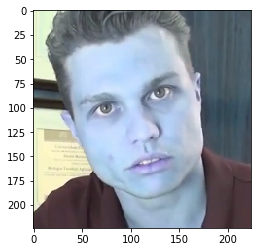

22


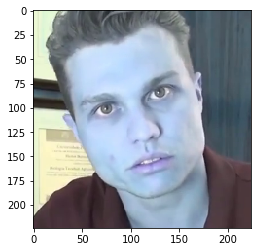

23


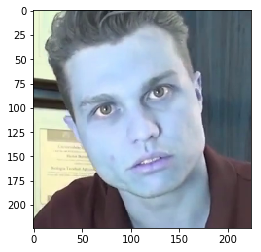

24


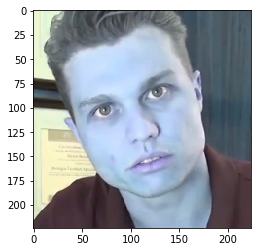

25


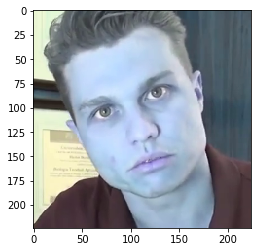

26


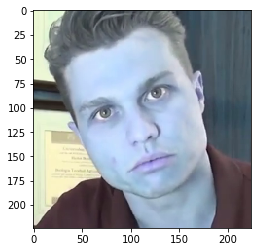

27


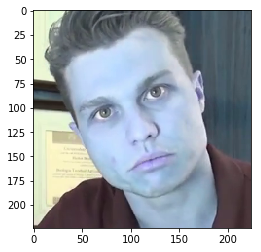

28


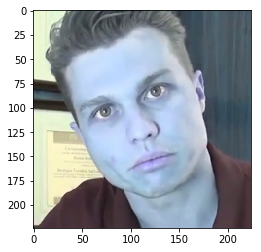

29


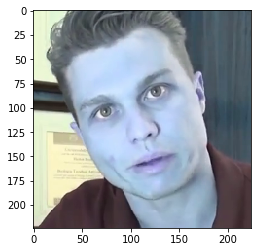

30


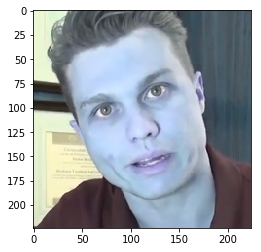

31


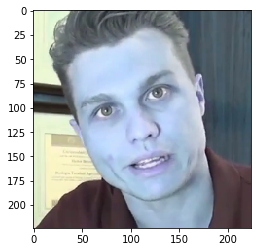

32


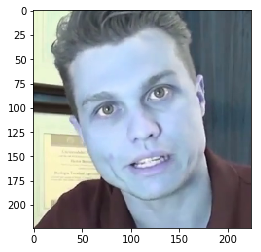

33


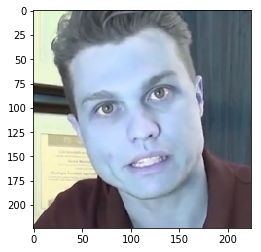

34


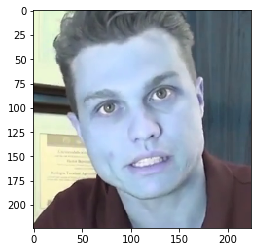

35


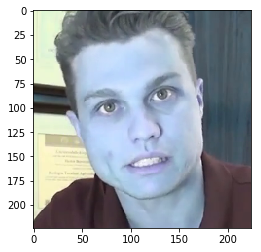

36


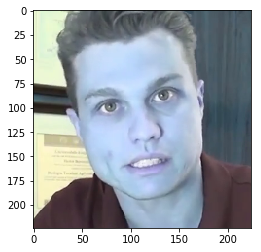

37


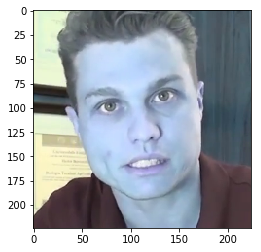

38


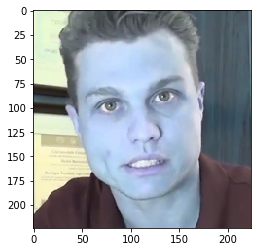

39


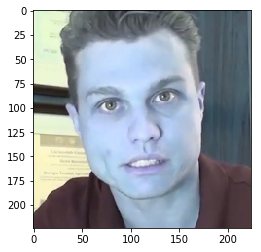

40


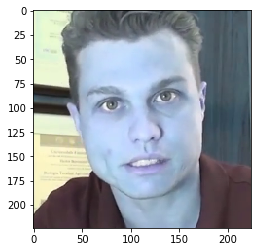

41


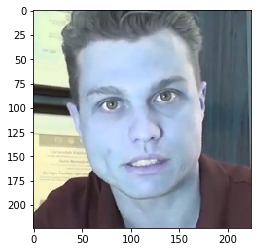

42


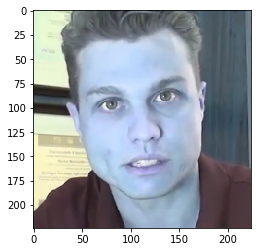

43


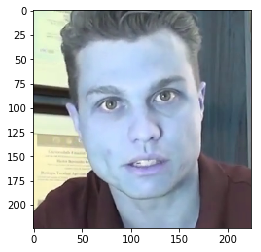

44


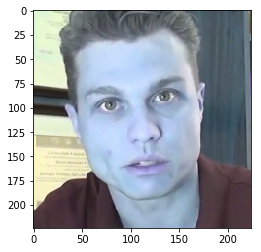

45


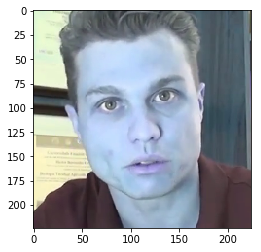

46


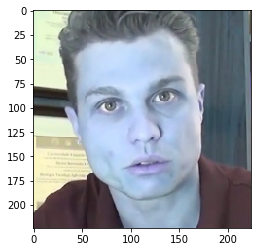

47


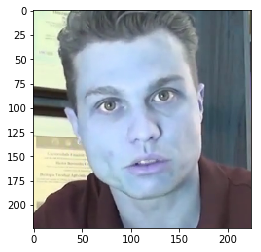

48


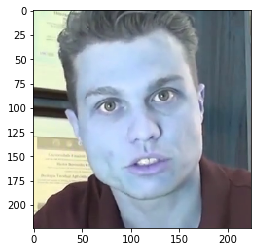

49


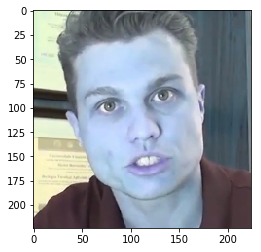

50


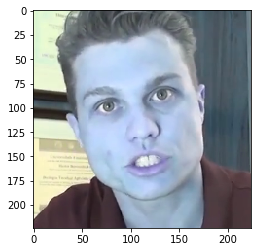

51


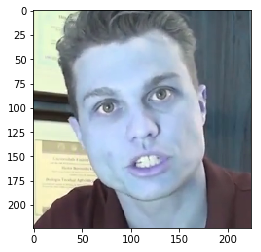

52


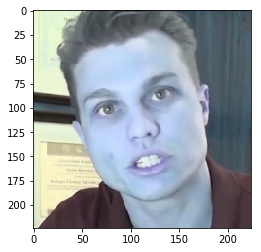

53


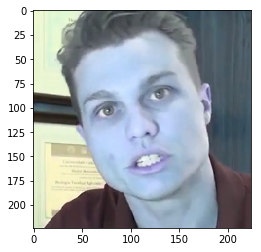

54


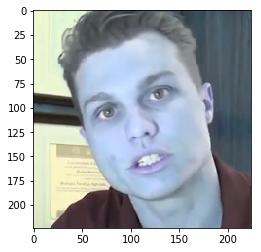

55


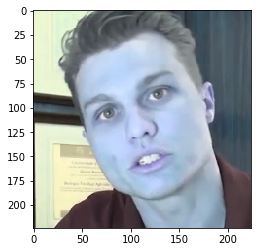

56


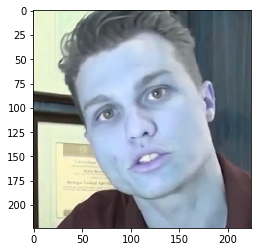

57


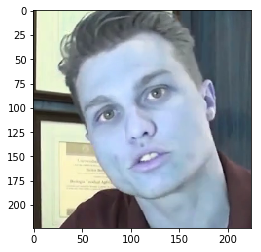

58


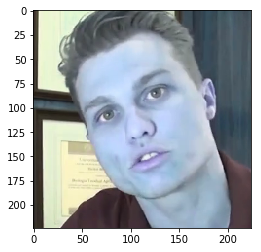

59


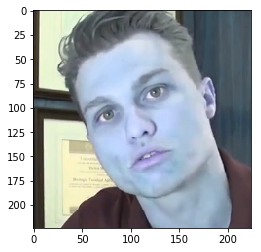

60


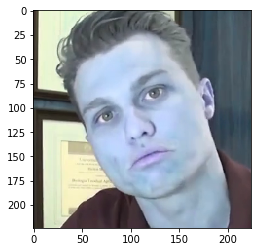

61


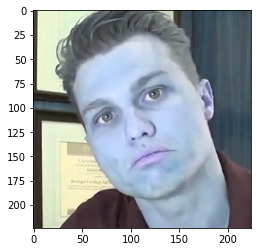

62


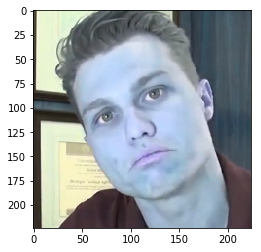

63


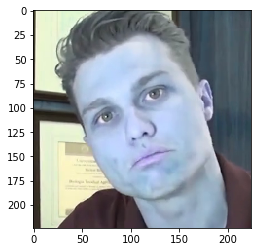

64


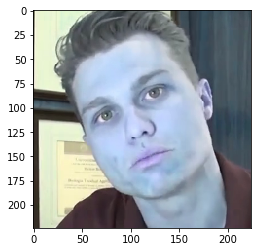

65


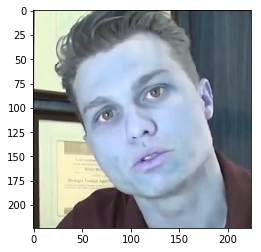

66


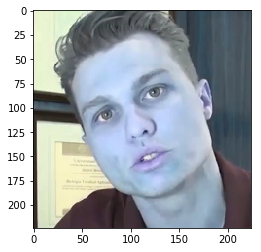

67


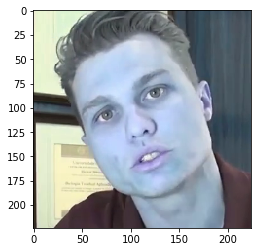

68


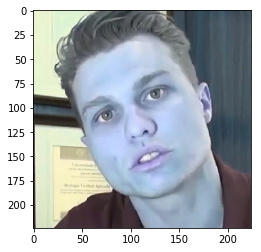

69


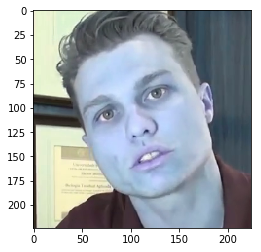

70


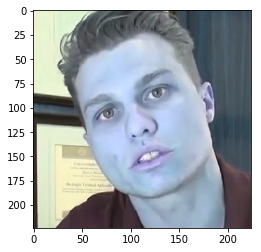

71


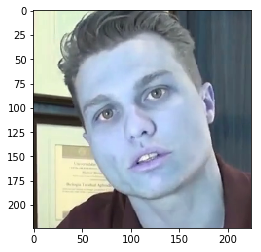

72


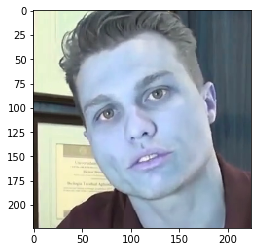

73


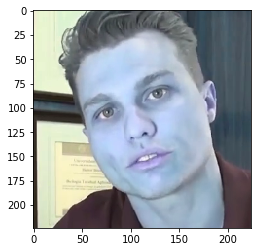

74


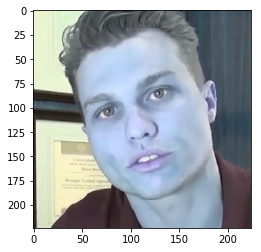

75


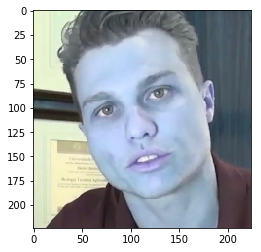

76


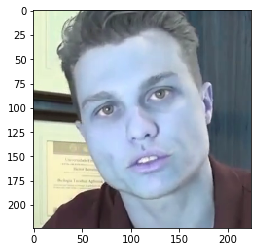

77


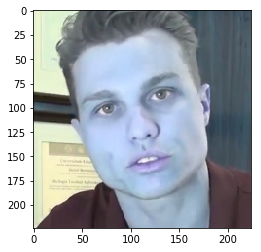

78


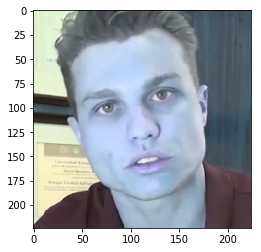

79


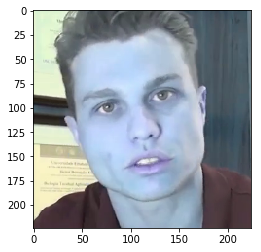

80


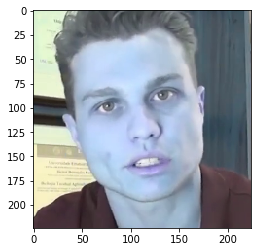

81


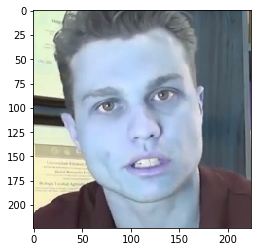

82


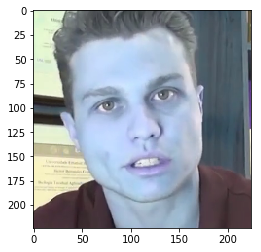

83


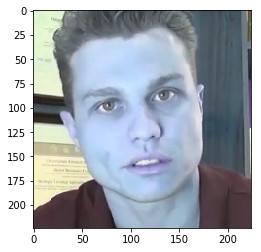

84


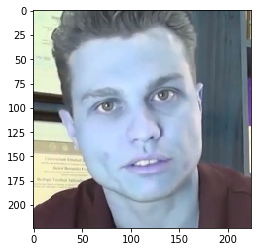

85


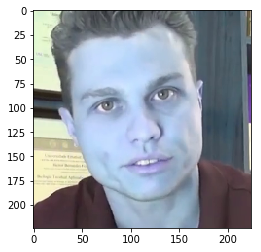

86


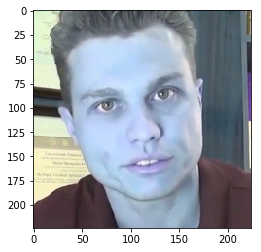

87


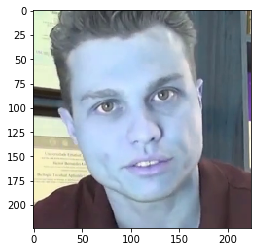

88


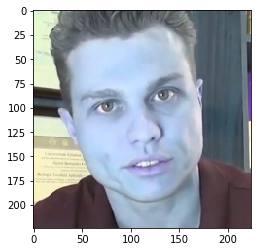

89


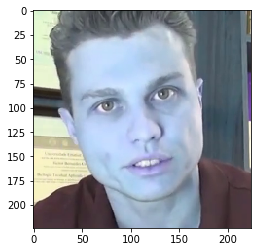

90


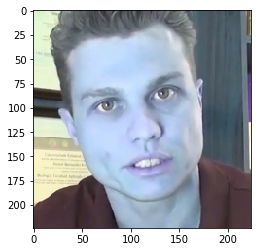

91


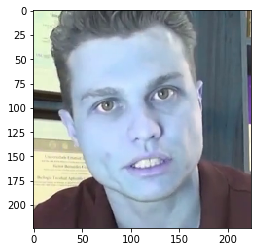

92


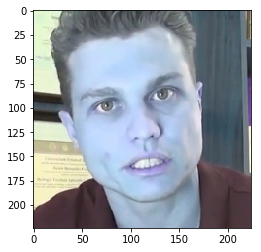

93


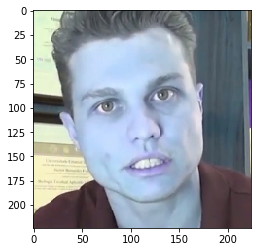

94


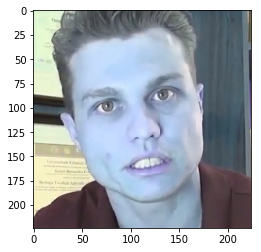

95


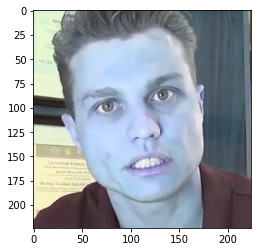

96


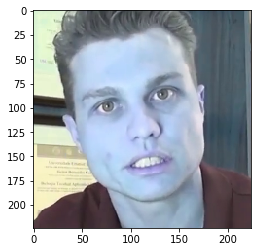

97


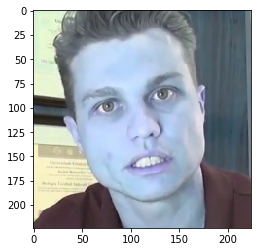

98


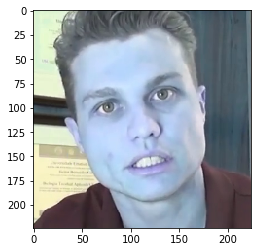

99


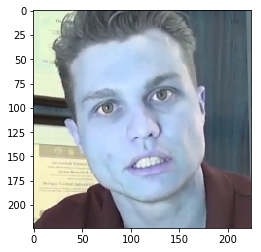

100


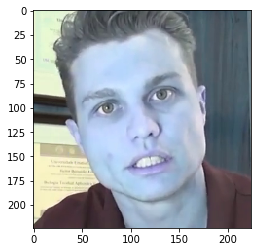

101


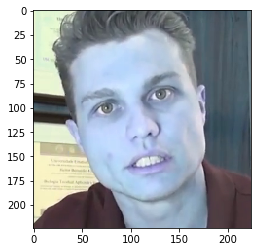

102


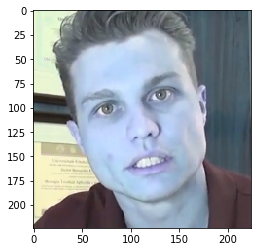

103


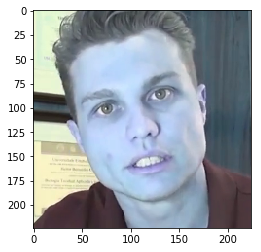

104


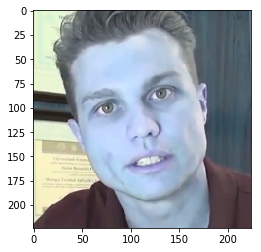

105


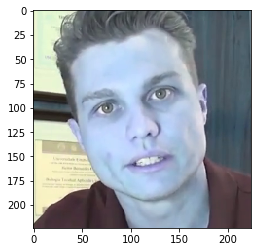

106


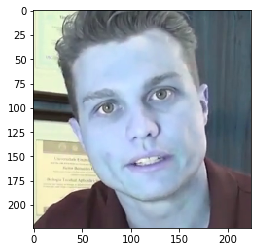

107


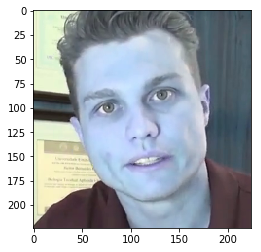

108


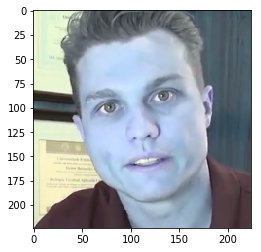

109


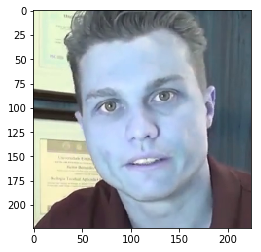

110


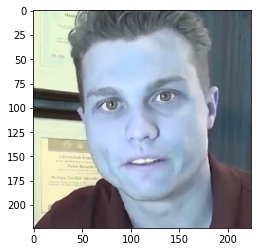

111


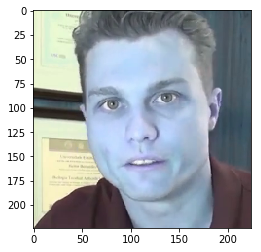

112


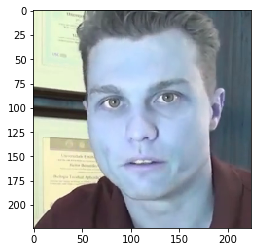

113


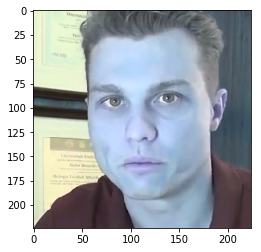

114


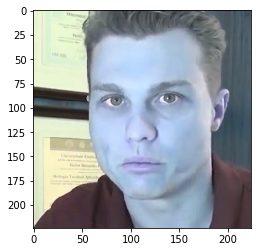

115


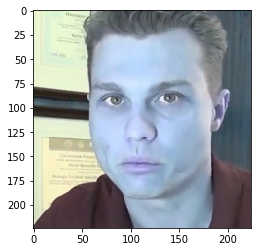

116


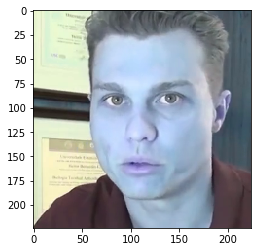

117


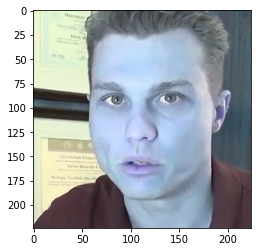

118


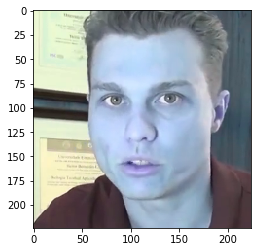

119


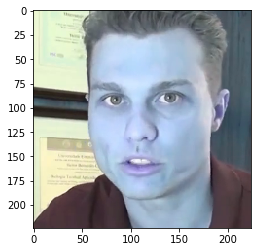

120


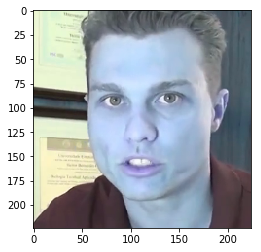

121


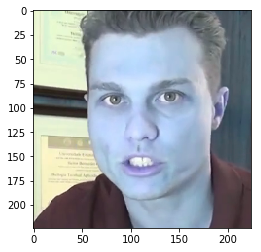

122


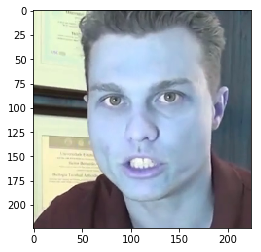

123


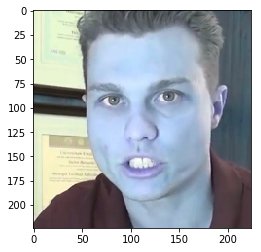

124


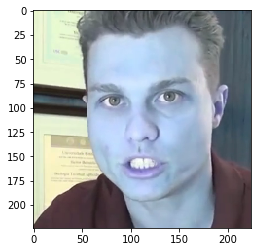

125


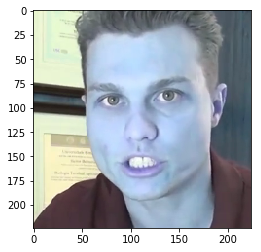

126


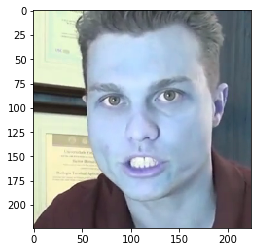

127


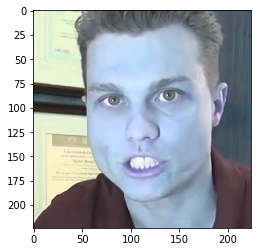

128


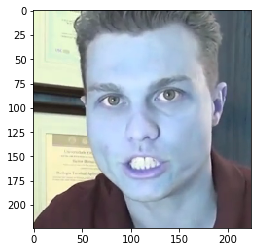

129


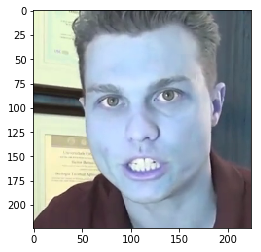

130


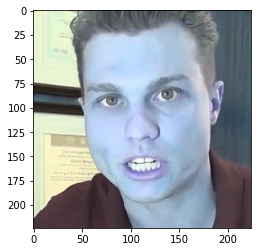

131


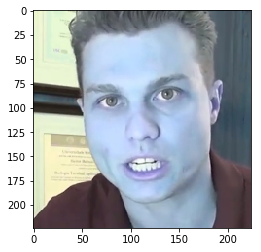

132


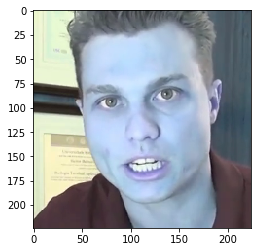

133


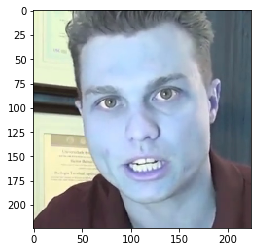

134


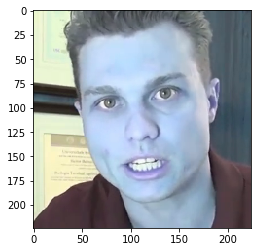

135


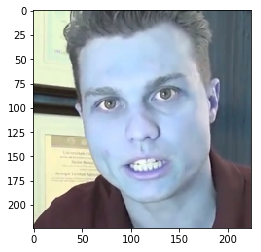

136


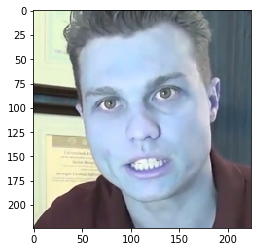

137


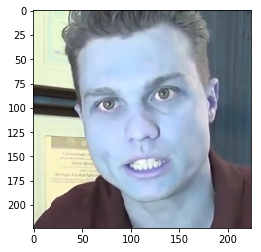

138


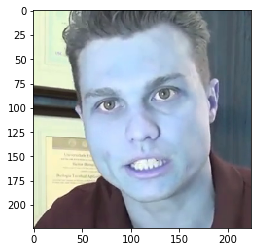

139


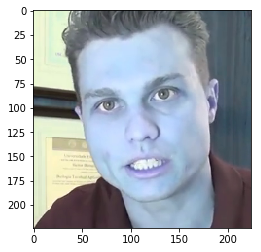

140


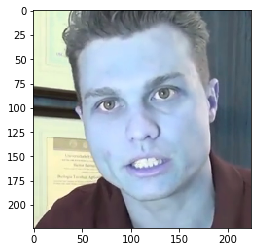

141


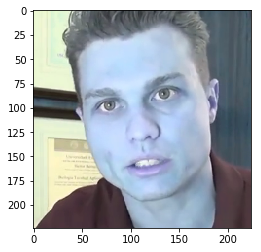

142


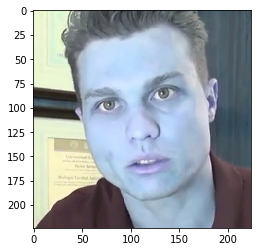

143


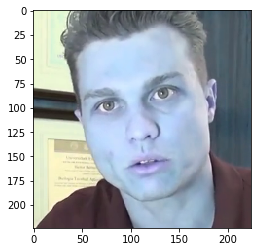

144


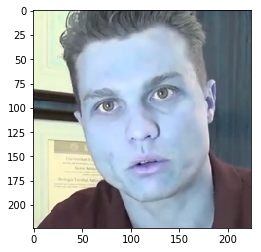

145


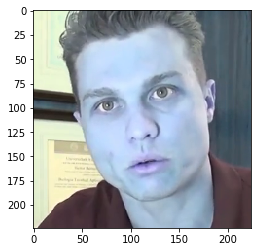

146


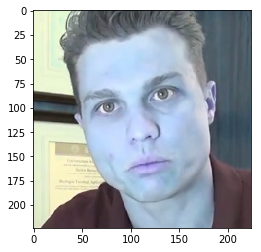

147


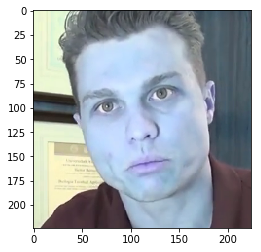

148


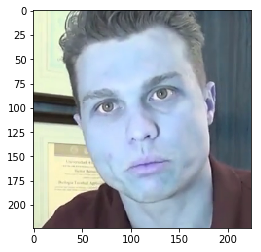

149


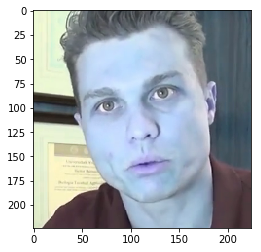

150


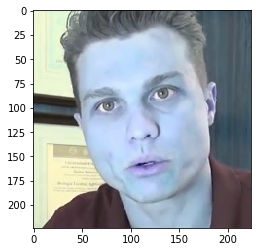

151


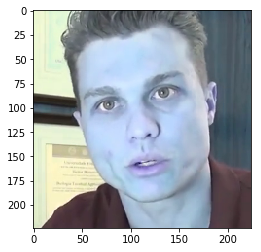

152


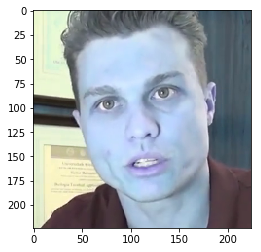

153


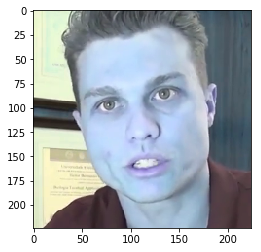

154


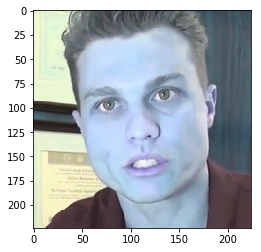

155


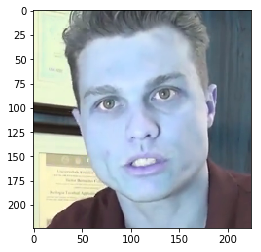

156


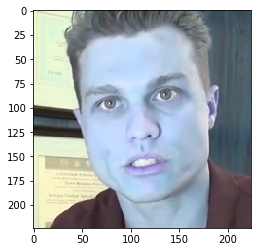

157


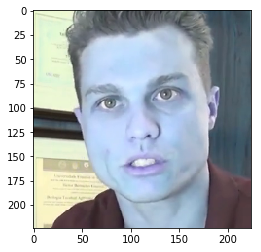

158


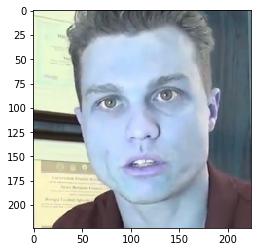

159


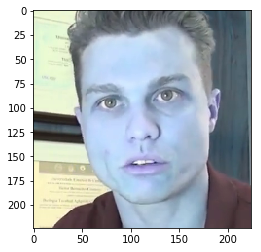

160


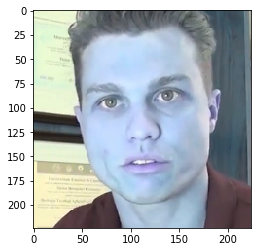

161


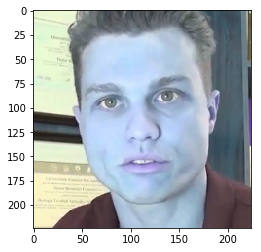

162


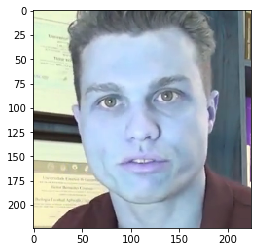

163


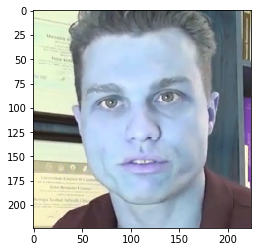

164


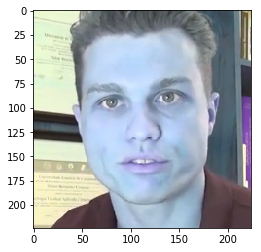

165


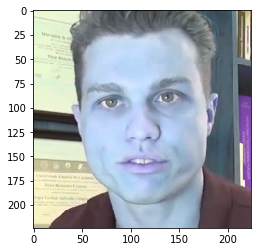

166


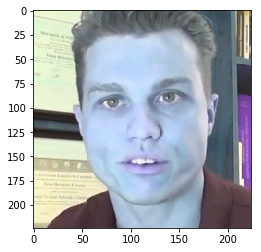

167


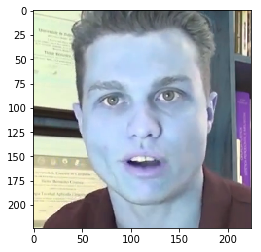

168


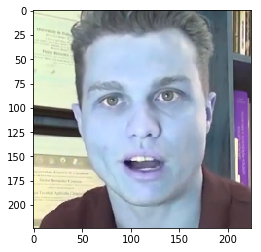

169


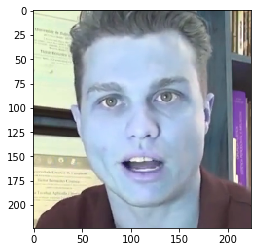

170


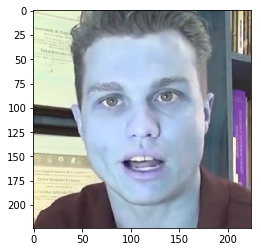

171


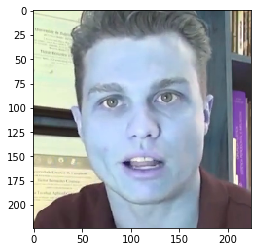

172


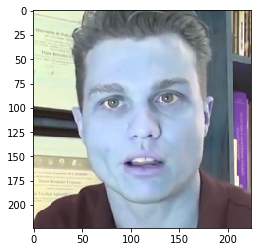

173


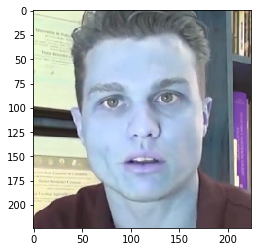

174


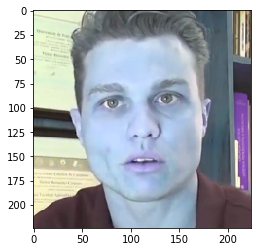

175


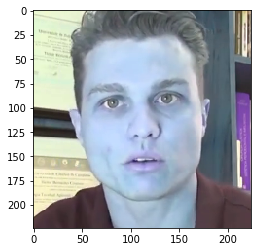

176


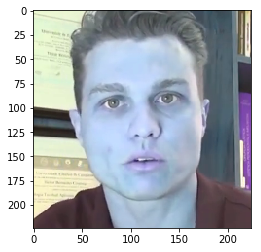

177


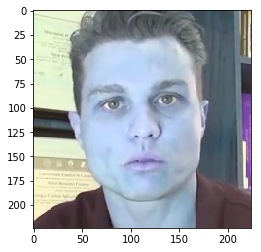

178


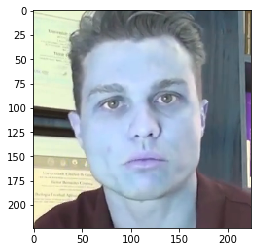

179


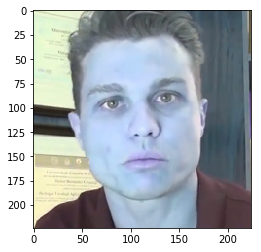

180


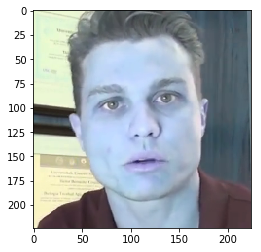

181


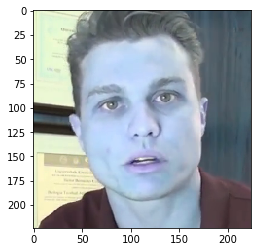

182


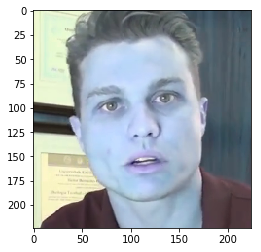

183


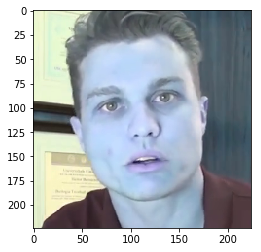

184


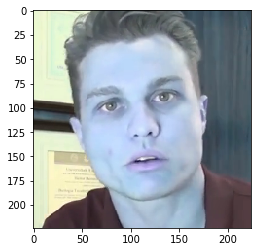

185


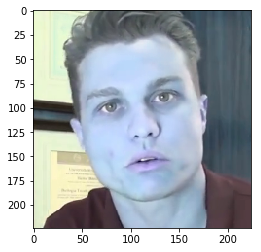

186


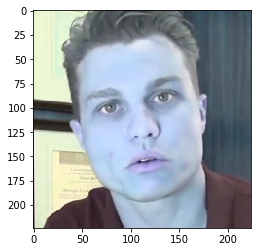

187


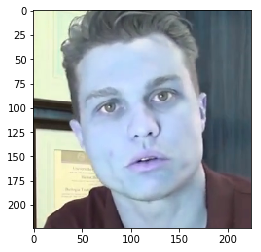

188


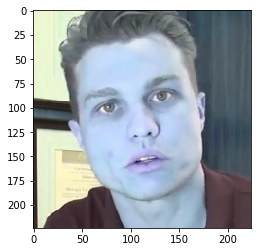

189


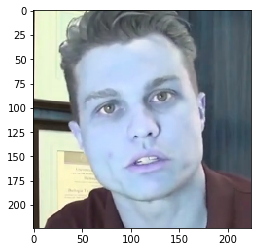

190


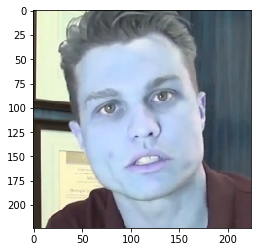

191


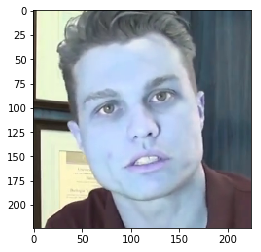

192


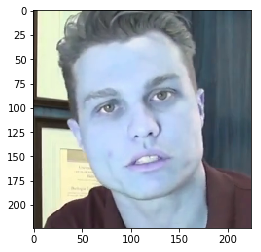

193


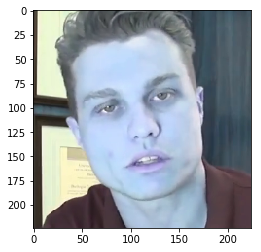

194


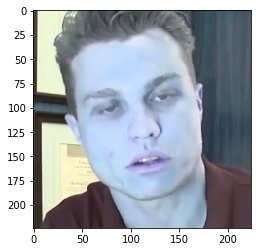

195


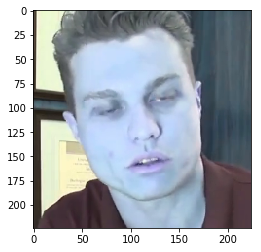

196


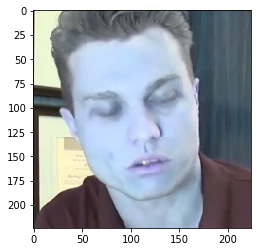

197


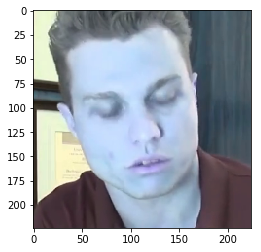

198


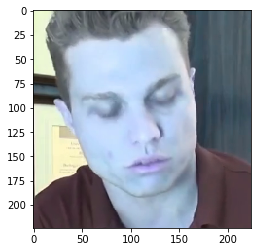

199


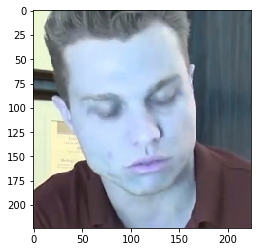

200


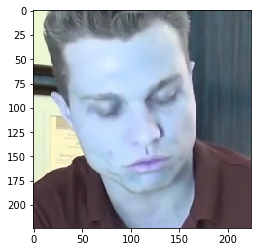

201


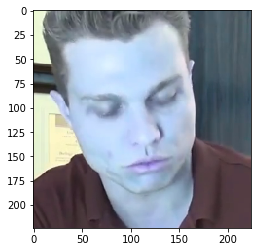

202


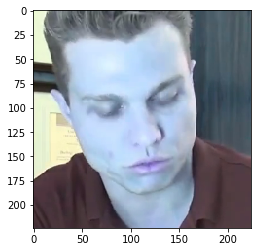

(203, 224, 224, 3)


In [101]:
for i, f in enumerate(all_frame):
    print(i)
    plt.imshow(f)
    plt.show()
print(all_frame.shape)

In [16]:
crop_np = '/Users/changdae/Desktop/MARG_Multi_Modal/dataset/result/numpy/cropped/_A15PFVHL04.npy'
cropped = np.load(crop_np)

In [17]:
print(cropped.shape)

(77, 224, 224, 3)


In [51]:
video_path = '/Users/changdae/Desktop/result/original/video/G1zWw7HKX8A.mp4'
vc = cv2.VideoCapture(video_path)
print(vc.get(cv2.CAP_PROP_FPS))
print(vc.get(cv2.CAP_PROP_FRAME_COUNT))

25.0
171.0


In [50]:
video_path = '/Users/changdae/Desktop/result/original/video/-wuxbgMRIWs'
resample_command = 'ffmpeg -y -i ' + video_path + '.mp4' + \
                               ' -r ' + str(25) + \
                               ' -c:v libx264 -b:v 3M -strict -2 -movflags faststart '\
                               + video_path + '_resampled.mp4'
subprocess.call(resample_command, shell=True)
print('asdasdasdas')

asdasdasdas
